# Assignment Customer Retension

# Problem Statement
E-retail factors for customer activation and retention: A case study from Indian e-commerce customers

Customer satisfaction has emerged as one of the most important factors that guarantee the success of online store; it has been posited as a key stimulant of purchase, repurchase intentions and customer loyalty. A comprehensive review of the literature, theories and models have been carried out to propose the models for customer activation and customer retention. Five major factors that contributed to the success of an e-commerce store have been identified as: service quality, system quality, information quality, trust and net benefit. The research furthermore investigated the factors that influence the online customers repeat purchase intention. The combination of both utilitarian value and hedonistic values are needed to affect the repeat purchase intention (loyalty) positively. The data is collected from the Indian online shoppers. Results indicate the e-retail success factors, which are very much critical for customer satisfaction.
Be careful: There are two sheets (one is detailed) and second is encoded in the excel file. You may use any of them by extracting in separate excel sheet. The number of column(s) is more than 47. Read the column header carefully.
Note : Data Scientists have to apply their analytical skills to give findings and conclusions in detailed data analysis written in jupyter notebook . Only data analysis is required.   
Need not to create machine learning models /but still if anybody comes with it that is welcome.


In [1]:
#import all libraries

import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")
import pandas_profiling
import missingno
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.preprocessing import OrdinalEncoder

In [2]:
#Load the dataset
xls = pd.ExcelFile('customer_retention_dataset.xlsx')
df1 = pd.read_excel(xls, 'datasheet') # sheet 1
df2 = pd.read_excel(xls, 'codedsheet') # sheet 2

In the above cell I have stored the excel file and then separated the spreadsheets in 2 different dataframes.

In [3]:
df1

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,...,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,...,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Amazon.in, Flipkart.com",Myntra.com,snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Myntra.com,"Amazon.in, Flipkart.com","Amazon.in, Myntra.com"
2,Female,21-30 years,Greater Noida,201308,3-4 years,41 times and above,Mobile Internet,Smartphone,5.5 inches,Android,...,Myntra.com,Myntra.com,Myntra.com,Myntra.com,Amazon.in,Paytm.com,Paytm.com,Paytm.com,Amazon.in,"Amazon.in, Paytm.com, Myntra.com"
3,Male,21-30 years,Karnal,132001,3-4 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,IOS/Mac,...,Snapdeal.com,"Myntra.com, Snapdeal.com",Myntra.com,Paytm.com,Paytm.com,Paytm.com,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Paytm.com","Amazon.in, Flipkart.com"
4,Female,21-30 years,Bangalore,530068,2-3 years,11-20 times,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Flipkart.com, Paytm.com",Paytm.com,Paytm.com,Paytm.com,Snapdeal.com,Paytm.com,Amazon.in,Snapdeal.com,Paytm.com,"Amazon.in, Myntra.com"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Female,21-30 years,Solan,173212,1-2 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,Android,...,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in
265,Female,31-40 years,Ghaziabad,201008,1-2 years,31-40 times,Mobile Internet,Smartphone,Others,Android,...,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com
266,Female,41-50 yaers,Bangalore,560010,2-3 years,Less than 10 times,Mobile internet,Laptop,Others,Window/windows Mobile,...,Amazon.in,Snapdeal.com,Amazon.in,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Amazon.in
267,Female,Less than 20 years,Solan,173229,2-3 years,Less than 10 times,Wi-Fi,Smartphone,5.5 inches,Android,...,Amazon.in,"Amazon.in, Myntra.com, Snapdeal.com",Amazon.in,"Amazon.in, Snapdeal.com",Amazon.in,Amazon.in,Amazon.in,"Myntra.com, Snapdeal.com","Myntra.com, Snapdeal.com",Amazon.in


We can see the spreadsheet df1 contains 269 rows and 71 columns.

In [4]:
df2

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,...,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?
0,0,3,Delhi,110009,5,4,4,3,5,1,...,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,1,2,Delhi,110030,5,5,2,1,2,3,...,"Amazon.in, Flipkart.com",Myntra.com,snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Myntra.com,"Amazon.in, Flipkart.com","Amazon.in, Myntra.com"
2,1,2,Greater Noida,201308,4,5,3,1,4,2,...,Myntra.com,Myntra.com,Myntra.com,Myntra.com,Amazon.in,Paytm.com,Paytm.com,Paytm.com,Amazon.in,"Amazon.in, Paytm.com, Myntra.com"
3,0,2,Karnal,132001,4,1,3,1,4,3,...,Snapdeal.com,"Myntra.com, Snapdeal.com",Myntra.com,Paytm.com,Paytm.com,Paytm.com,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Paytm.com","Amazon.in, Flipkart.com"
4,1,2,Bangalore,530068,3,2,2,1,2,3,...,"Flipkart.com, Paytm.com",Paytm.com,Paytm.com,Paytm.com,Snapdeal.com,Paytm.com,Amazon.in,Snapdeal.com,Paytm.com,"Amazon.in, Myntra.com"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,1,2,Solan,173212,2,1,3,1,4,2,...,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in,Amazon.in
265,1,3,Ghaziabad,201008,2,4,3,1,5,2,...,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com,Flipkart.com
266,1,4,Bangalore,560010,3,1,3,2,5,1,...,Amazon.in,Snapdeal.com,Amazon.in,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Amazon.in
267,1,1,Solan,173229,3,1,2,1,4,2,...,Amazon.in,"Amazon.in, Myntra.com, Snapdeal.com",Amazon.in,"Amazon.in, Snapdeal.com",Amazon.in,Amazon.in,Amazon.in,"Myntra.com, Snapdeal.com","Myntra.com, Snapdeal.com",Amazon.in


We can see the spreadsheet df2 contains 269 rows and 71 columns.

# Exploratory Data analysis (EDA)

In [5]:
pd.set_option('display.max_columns', None) # show all columns in a dataframe
pd.set_option('display.max_rows', None) # show all rows in a dataframe

Ensuring that in future observations we do not have any truncated information being displayed in our Jupter Notebook.

In [6]:
df1.columns

Index(['1Gender of respondent', '2 How old are you? ',
       '3 Which city do you shop online from?',
       '4 What is the Pin Code of where you shop online from?',
       '5 Since How Long You are Shopping Online ?',
       '6 How many times you have made an online purchase in the past 1 year?',
       '7 How do you access the internet while shopping on-line?',
       '8 Which device do you use to access the online shopping?',
       '9 What is the screen size of your mobile device?\t\t\t\t\t\t                                        ',
       '10 What is the operating system (OS) of your device?\t\t\t\t                                          ',
       '11 What browser do you run on your device to access the website?\t\t\t                                                          ',
       '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ',
       '13 After first visit, how 

As these column names are too long we will replace them for more easier understanding

In [7]:
df1.rename(columns = {'1Gender of respondent':'Gender', 
       '2 How old are you? ':'Age',
       '3 Which city do you shop online from?':'City',
       '4 What is the Pin Code of where you shop online from?':'Pin Code',
       '5 Since How Long You are Shopping Online ?':'Online Shopping Duration',
       '6 How many times you have made an online purchase in the past 1 year?':'Online purchase in past 1 year',
       '7 How do you access the internet while shopping on-line?':'Mode of internet access',
       '8 Which device do you use to access the online shopping?':'Device used for internet access',
       '9 What is the screen size of your mobile device?\t\t\t\t\t\t                                        ':'Screen size of mobile',
       '10 What is the operating system (OS) of your device?\t\t\t\t                                          ':'Operating System',
       '11 What browser do you run on your device to access the website?\t\t\t                                                          ':'Browser',
       '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ':'Channel used for 1st visit',
       '13 After first visit, how do you reach the online retail store?\t\t\t\t                                                   ':'Online store access post 1st visit',
       '14 How much time do you explore the e- retail store before making a purchase decision?                                                                   ':'Time invested to explore and purchase',
       '15 What is your preferred payment Option?\t\t\t\t\t                                                                                                                               ':'Preferred payment option',
       '16 How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?\t\t\t\t\t\t\t                                                   ':'Frequency to abandon purchase from a cart',
       '17 Why did you abandon the “Bag”, “Shopping Cart”?\t\t\t\t\t                                                                                                                                                       ':'Reason to abandon purchase from a cart',
       '18 The content on the website must be easy to read and understand':'Shopping website content readability',
       '19 Information on similar product to the one highlighted  is important for product comparison':'Importance of product comparison content',
       '20 Complete information on listed seller and product being offered is important for purchase decision.':'Importance of seller and product detail for purchase decision',
       '21 All relevant information on listed products must be stated clearly':'Clarity on relevant information for products',
       '22 Ease of navigation in website':'Ease of navigation on website', 
       '23 Loading and processing speed':'Loading and processing speed of website',
       '24 User friendly Interface of the website':'Ease of access on GUI of website',
       '25 Convenient Payment methods':'Convenient/Most used payment methods',
       '26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time':'On time product delivery',
       '27 Empathy (readiness to assist with queries) towards the customers':'Empathy towards the customer',
       '28 Being able to guarantee the privacy of the customer':'Privacy guarantee of the customer',
       '29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)':'Support availability via various means',
       '30 Online shopping gives monetary benefit and discounts':'Offers and Discounts on online shopping',
       '31 Enjoyment is derived from shopping online':'Enjoyment quotient in online shopping',
       '32 Shopping online is convenient and flexible':'Flexibity in online shopping',
       '33 Return and replacement policy of the e-tailer is important for purchase decision':'Return and Replacement policy',
       '34 Gaining access to loyalty programs is a benefit of shopping online':'Loyalty program benefits',
       '35 Displaying quality Information on the website improves satisfaction of customers':'Quality of website content',
       '36 User derive satisfaction while shopping on a good quality website or application':'User satisfaction',
       '37 Net Benefit derived from shopping online can lead to users satisfaction':'Net benefit',
       '38 User satisfaction cannot exist without trust':'User satisfaction with trust factor',
       '39 Offering a wide variety of listed product in several category':'Wide range of products',
       '40 Provision of complete and relevant product information':'Relevance in product details',
       '41 Monetary savings':'Monetary savings',
       '42 The Convenience of patronizing the online retailer':'Frequency of purchase from a seller',
       '43 Shopping on the website gives you the sense of adventure':'Sense of adventure',
       '44 Shopping on your preferred e-tailer enhances your social status':'Social status',
       '45 You feel gratification shopping on your favorite e-tailer':'Pleasure in shopping from a seller',
       '46 Shopping on the website helps you fulfill certain roles':'Fulfill roles from shopping',
       '47 Getting value for money spent':'Value for money',
       'From the following, tick any (or all) of the online retailers you have shopped from;                                                                           ':'List of online shopping websites',
       'Easy to use website or application':'Ease of access on an online website',
       'Visual appealing web-page layout':'Website layout', 
       'Wild variety of product on offer':'Variety of products on offer',
       'Complete, relevant description information of products':'Completeness of product description',
       'Fast loading website speed of website and application':'Website access speed',
       'Reliability of the website or application':'Reliability of website',
       'Quickness to complete purchase':'Ease to complete purchase',
       'Availability of several payment options':'Payment option availability', 
       'Speedy order delivery ':'Fast delivery',
       'Privacy of customers’ information':'Customer privacy',
       'Security of customer financial information':'Security on payment details',
       'Perceived Trustworthiness':'Trust worthiness',
       'Presence of online assistance through multi-channel':'Online presence of support team',
       'Longer time to get logged in (promotion, sales period)':'Time to login website on special offer days',
       'Longer time in displaying graphics and photos (promotion, sales period)':'Time to load media on special offer days',
       'Late declaration of price (promotion, sales period)':'Delay in declaring special offer details',
       'Longer page loading time (promotion, sales period)':'Time to load website on special offer days',
       'Limited mode of payment on most products (promotion, sales period)':'Limited mode of payment on special offer days',
       'Longer delivery period':'Delayed product delivery', 
       'Change in website/Application design':'Change in GUI',
       'Frequent disruption when moving from one page to another':'Issue accessing multiple pages of a website',
       'Website is as efficient as before':'Efficiency of website at all times',
       'Which of the Indian online retailer would you recommend to a friend?':'Recommendation quotient'},inplace = True)

In [8]:
df1.shape

(269, 71)

269 rows and 71 columns

In [9]:
# after renaming lets take a look of our dataset
df1.head()

,Gender,Age,City,Pin Code,Online Shopping Duration,Online purchase in past 1 year,Mode of internet access,Device used for internet access,Screen size of mobile,Operating System,Browser,Channel used for 1st visit,Online store access post 1st visit,Time invested to explore and purchase,Preferred payment option,Frequency to abandon purchase from a cart,Reason to abandon purchase from a cart,Shopping website content readability,Importance of product comparison content,Importance of seller and product detail for purchase decision,Clarity on relevant information for products,Ease of navigation on website,Loading and processing speed of website,Ease of access on GUI of website,Convenient/Most used payment methods,On time product delivery,Empathy towards the customer,Privacy guarantee of the customer,Support availability via various means,Offers and Discounts on online shopping,Enjoyment quotient in online shopping,Flexibity in online shopping,Return and Replacement policy,Loyalty program benefits,Quality of website content,User satisfaction,Net benefit,User satisfaction with trust factor,Wide range of products,Relevance in product details,Monetary savings,Frequency of purchase from a seller,Sense of adventure,Social status,Pleasure in shopping from a seller,Fulfill roles from shopping,Value for money,List of online shopping websites,Ease of access on an online website,Website layout,Variety of products on offer,Completeness of product description,Website access speed,Reliability of website,Ease to complete purchase,Payment option availability,Fast delivery,Customer privacy,Security on payment details,Trust worthiness,Online presence of support team,Time to login website on special offer days,Time to load media on special offer days,Delay in declaring special offer details,Time to load website on special offer days,Limited mode of payment on special offer days,Delayed product delivery,Change in GUI,Issue accessing multiple pages of a website,Efficiency of website at all times,Recommendation quotient
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,Google chrome,Search Engine,Search Engine,6-10 mins,"E-wallets (Paytm, Freecharge etc.)",Sometimes,Lack of trust,Agree (4),Indifferent (3),Indifferent (3),Agree (4),Agree (4),Strongly disagree (1),Dis-agree (2),Dis-agree (2),Disagree (2),Strongly agree (5),Agree (4),Agree (4),indifferent (3),Strongly disagree (1),Dis-agree (2),Dis-agree (2),Agree (4),indifferent (3),Strongly agree (5),Agree (4),Strongly agree (5),indifferent (3),indifferent (3),Disagree (2),indifferent (3),Agree (4),Agree (4),Strongly agree (5),Agree (4),Strongly agree (5),"Amazon.in, Paytm.com",Paytm.com,Flipkart.com,Flipkart.com,Snapdeal.com,Snapdeal.com,Paytm.com,Paytm.com,Patym.com,Amazon.in,Amazon.in,Amazon.in,Flipkart.com,Paytm.com,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,Google chrome,Search Engine,Via application,more than 15 mins,Credit/Debit cards,Very frequently,Promo code not applicable,Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),Strongly agree (5),indifferent (3),indifferent (3),indifferent (3),Strongly agree (5),Strongly agree (5),Strongly agree (5),"Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com","Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com","Amazon.in, Myntra.com","Flipkart.com, Myntra.com","Amazon.in, Flipkart.com, Myntra.com","Amazon.in, Flipkart.com, Myntra.com",Myntra.com,"Amazon.com, Fl

# Checking Null Values

In [10]:
df1.isnull().sum()

Gender                                                           0
Age                                                              0
City                                                             0
Pin Code                                                         0
Online Shopping Duration                                         0
Online purchase in past 1 year                                   0
Mode of internet access                                          0
Device used for internet access                                  0
Screen size of mobile                                            0
Operating System                                                 0
Browser                                                          0
Channel used for 1st visit                                       0
Online store access post 1st visit                               0
Time invested to explore and purchase                            0
Preferred payment option                                      

We dont have any missing values in our data. However we can confirm the same with visual on it.

<AxesSubplot:>

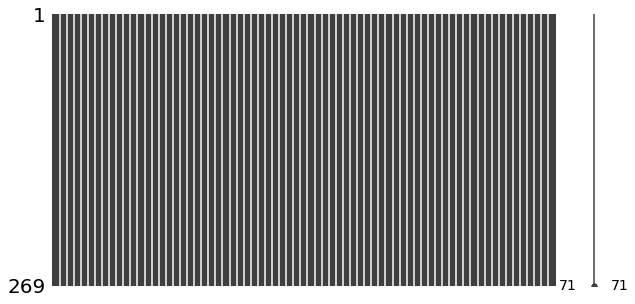

In [11]:
missingno.matrix(df1, figsize = (10,5))

from above matrix we can see that there are no missing values in our dataset

# Descriptive Statistics

In [12]:
df1.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Gender,269,2,Female,181,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,269,5,31-40 years,81,NaN,NaN,NaN,NaN,NaN,NaN,NaN
City,269,11,Delhi,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pin Code,269.0,NaN,NaN,NaN,220465.747212,140524.341051,110008.0,122018.0,201303.0,201310.0,560037.0
Online Shopping Duration,269,5,Above 4 years,98,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Online purchase in past 1 year,269,6,Less than 10 times,114,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Mode of internet access,269,4,Mobile internet,142,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Device used for internet access,269,4,Smartphone,141,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Screen size of mobile,269,4,Others,134,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Operating System,269,3,Window/windows Mobile,122,NaN,NaN,NaN,NaN,NaN,NaN,NaN


With the help of describe method in transpose format we are able to take a look at our column details clearly. The count column once again confirms that there are no missing data concern in our dataset. Also I have used the include all parameter in the describe method to ensure all the columns are displayed irrespective of it being a numeric or text data column.

In [13]:
df1.info() # checking the datatype information on columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269 entries, 0 to 268
Data columns (total 71 columns):
 #   Column                                                         Non-Null Count  Dtype 
---  ------                                                         --------------  ----- 
 0   Gender                                                         269 non-null    object
 1   Age                                                            269 non-null    object
 2   City                                                           269 non-null    object
 3   Pin Code                                                       269 non-null    int64 
 4   Online Shopping Duration                                       269 non-null    object
 5   Online purchase in past 1 year                                 269 non-null    object
 6   Mode of internet access                                        269 non-null    object
 7   Device used for internet access                                269 non-

Here we can see that all columns are of object datatype except pincode column which is of integer datatype

In [14]:
df1.nunique().to_frame("Unique Values")

,Unique Values
Gender,2
Age,5
City,11
Pin Code,39
Online Shopping Duration,5
Online purchase in past 1 year,6
Mode of internet access,4
Device used for internet access,4
Screen size of mobile,4
Operating System,3


We can all unique values of each columns and it also shows that there are not much unique values so we can plot it easily in our visualizations

In [15]:
 for i in df1.columns:
    print(i)
    print(df1[i].value_counts().to_frame("Values Counts"))
    print("*"*120)

Gender
        Values Counts
Female            181
Male               88
************************************************************************************************************************
Age
                    Values Counts
31-40 years                    81
21-30 years                    79
41-50 yaers                    70
Less than 20 years             20
51 years and above             19
************************************************************************************************************************
City
               Values Counts
Delhi                     58
Greater Noida             43
Noida                     40
Bangalore                 37
Karnal                    27
Solan                     18
Ghaziabad                 18
Gurgaon                   12
Merrut                     9
Moradabad                  5
Bulandshahr                2
************************************************************************************************************************
Pin

I have listed down all the data column values to see clearly what are are unique values and how many rows they cover in our dataframe.

# Duplicates

In [16]:
df1.duplicated().sum()

166

Here in this kind of data it is possible that there are duplicates because many customer may have same choises. And also we have 269 rows in total if i remove 166 duplicates i will remain with only 106 rows so I am going to keep this data

# Visualization

In [17]:
# taking only object datatype
obj_d = []
for x in df1.dtypes.index:
    if df1.dtypes[x] == 'O':
        obj_d.append(x)
obj_d

['Gender',
 'Age',
 'City',
 'Online Shopping Duration',
 'Online purchase in past 1 year',
 'Mode of internet access',
 'Device used for internet access',
 'Screen size of mobile',
 'Operating System',
 'Browser',
 'Channel used for 1st visit',
 'Online store access post 1st visit',
 'Time invested to explore and purchase',
 'Preferred payment option',
 'Frequency to abandon purchase from a cart',
 'Reason to abandon purchase from a cart',
 'Shopping website content readability',
 'Importance of product comparison content',
 'Importance of seller and product detail for purchase decision',
 'Clarity on relevant information for products',
 'Ease of navigation on website',
 'Loading and processing speed of website',
 'Ease of access on GUI of website',
 'Convenient/Most used payment methods',
 'On time product delivery',
 'Empathy towards the customer',
 'Privacy guarantee of the customer',
 'Support availability via various means',
 'Offers and Discounts on online shopping',
 'Enjoyment

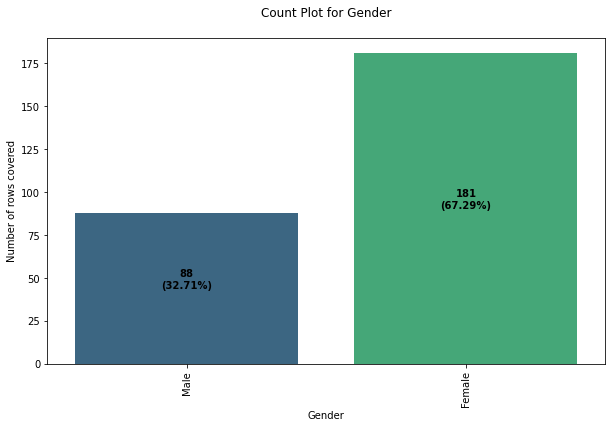

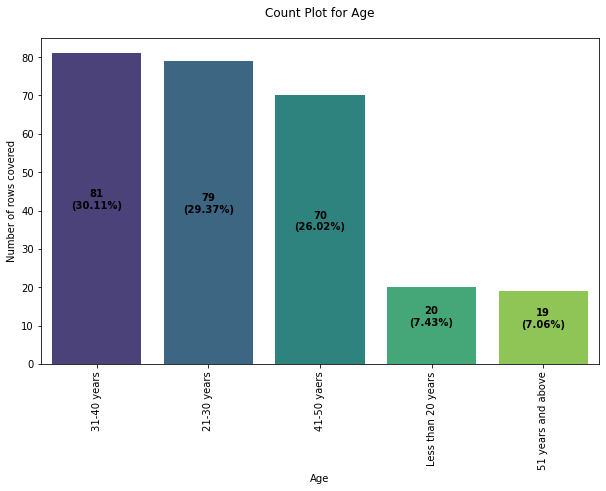

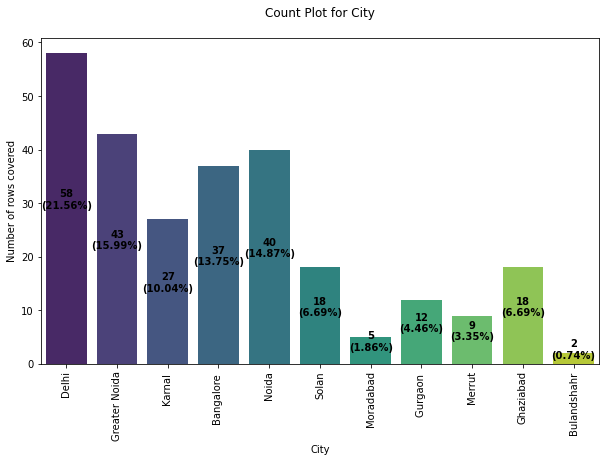

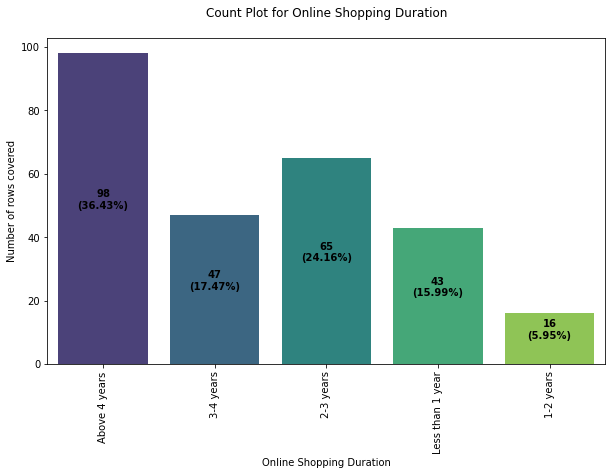

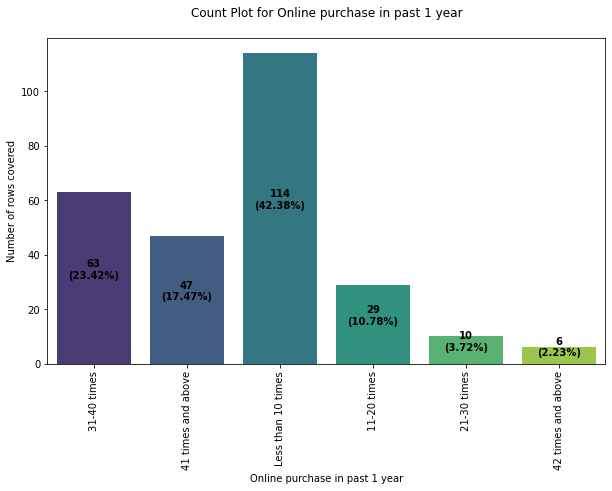

...

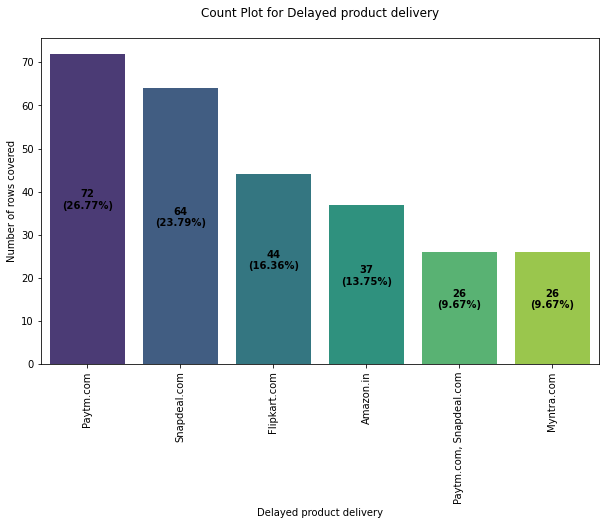

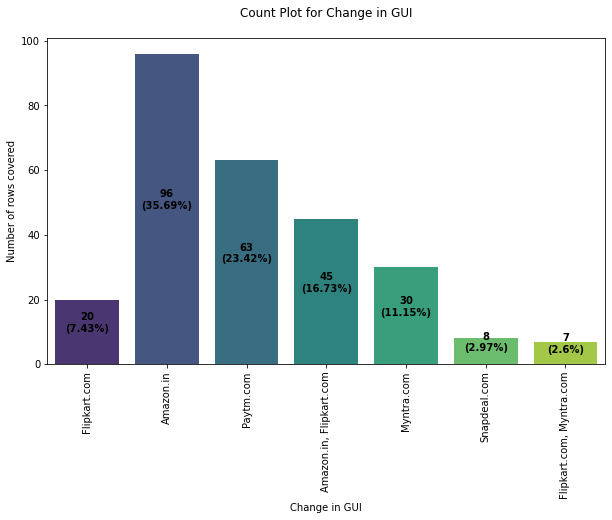

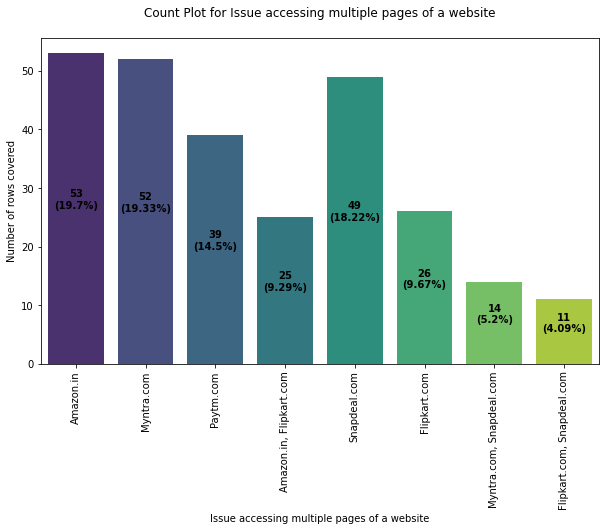

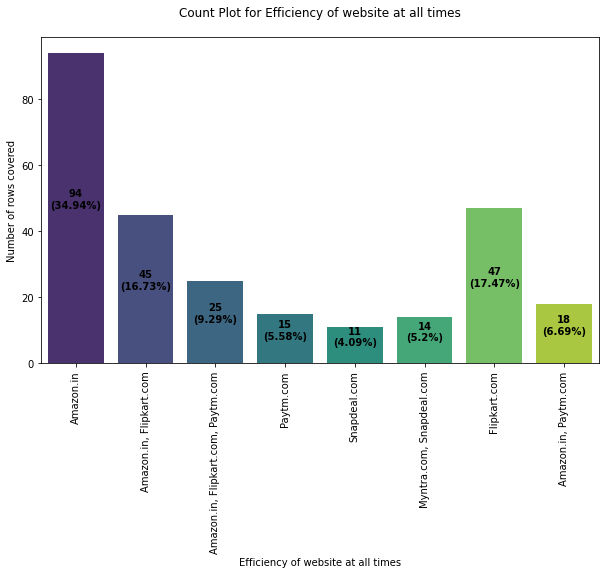

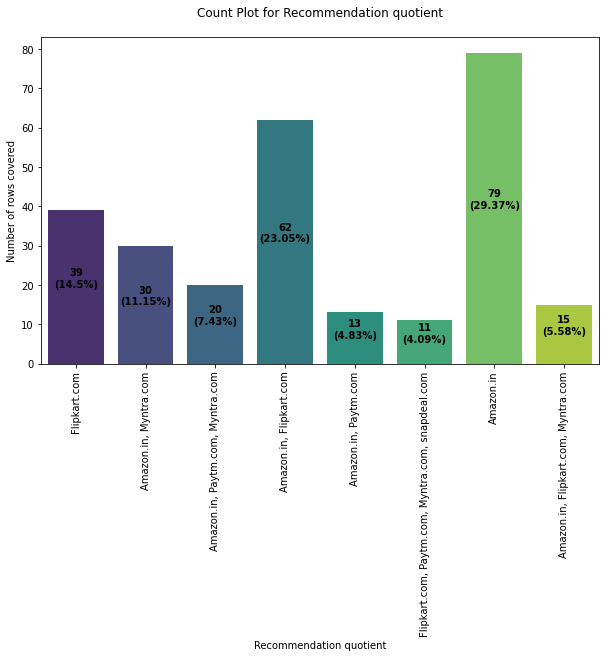

In [18]:
# plotting object data type count plot
for col in df1[obj_d]:
    plt.figure(figsize=(10,6))
    col_name = col
    values = df1[col_name].value_counts()
    index = 0
    ax = sns.countplot(df1[col_name], palette="viridis")

    for i in ax.patches:
        h = i.get_height() # getting the count of each value
        t = len(df1[col_name]) # getting the total number of records using length
        s = f"{h}\n({round(h*100/t,2)}%)" # making the string for displaying in count bar
        plt.text(index, h/2, s, ha="center", fontweight="bold")
        index += 1
    
    plt.title(f"Count Plot for {col_name}\n")
    plt.xlabel(col_name)
    plt.ylabel(f"Number of rows covered")
    plt.xticks(rotation=90)
    plt.show()

# Let's plot all feature columns count referring to the Gender

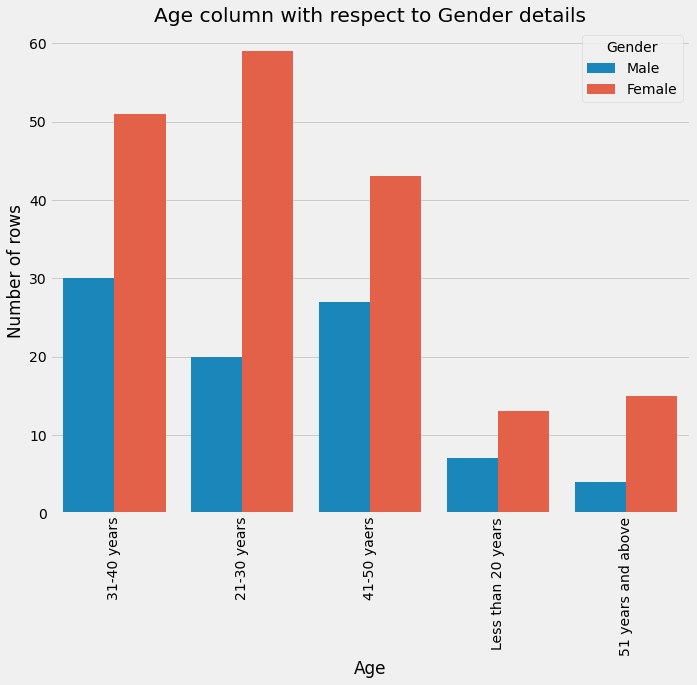

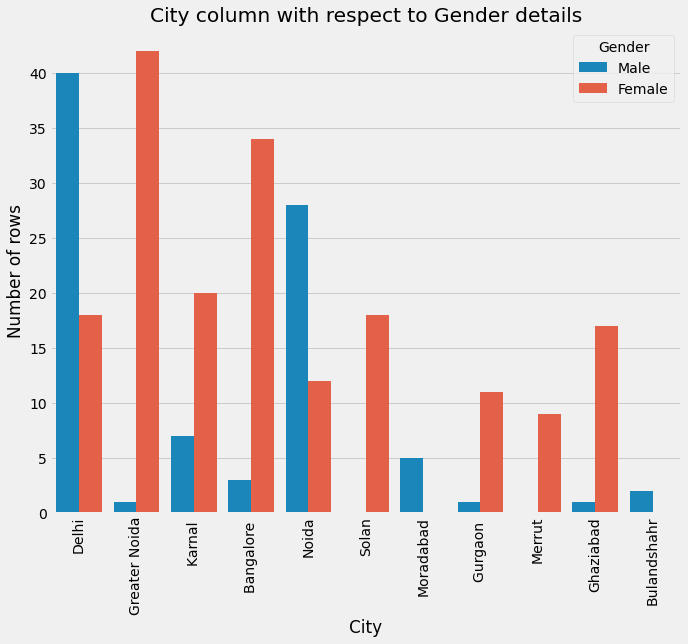

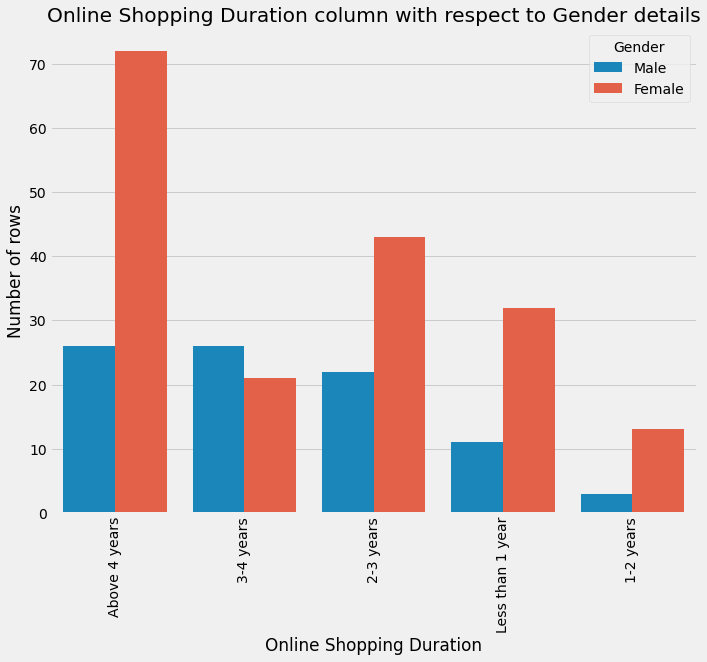

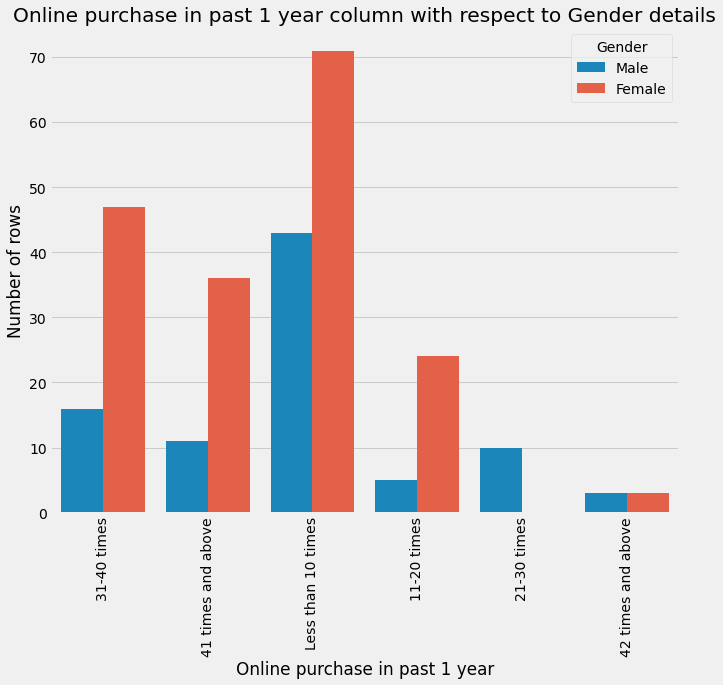

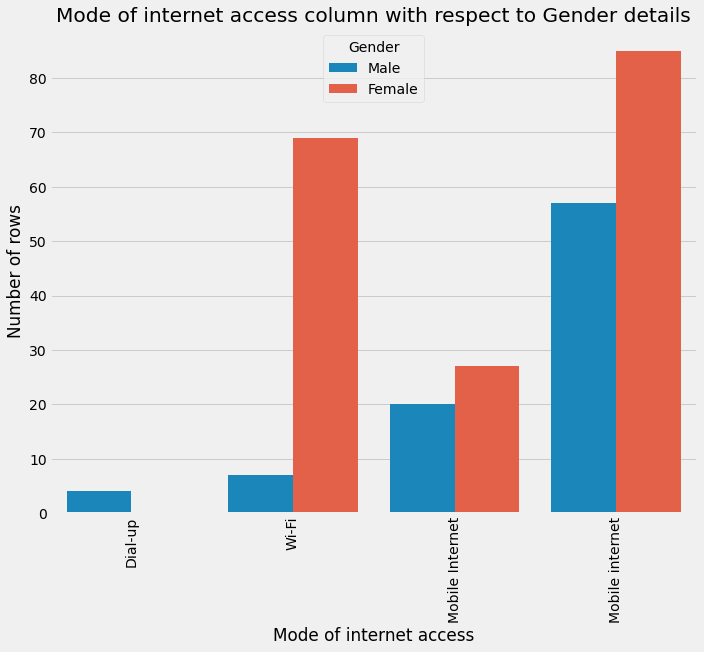

...

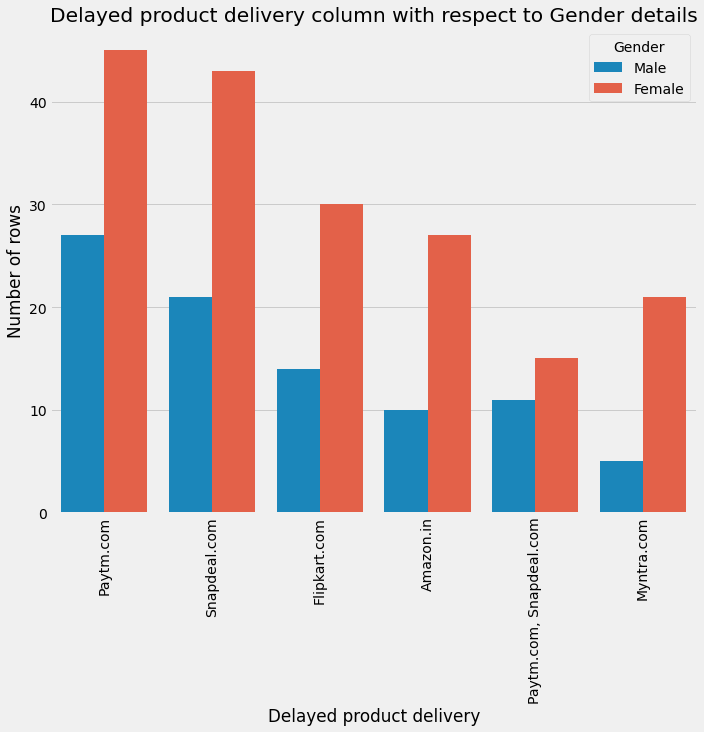

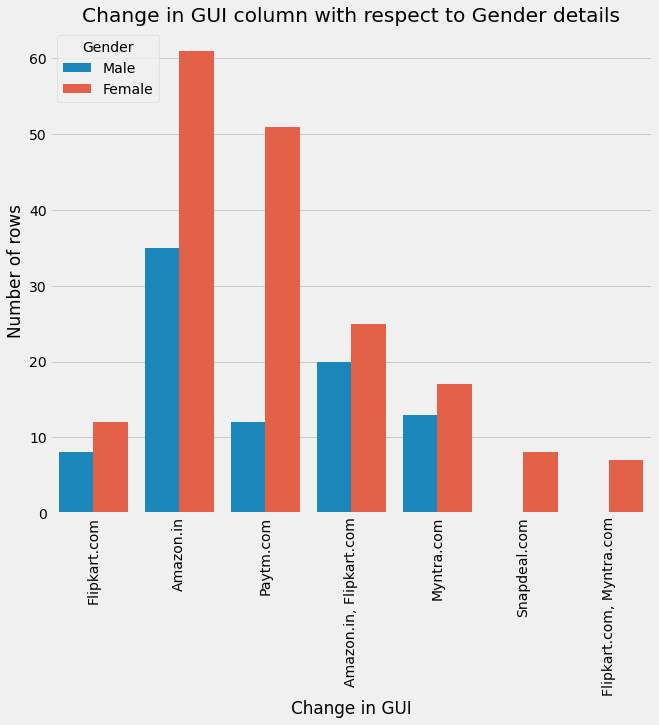

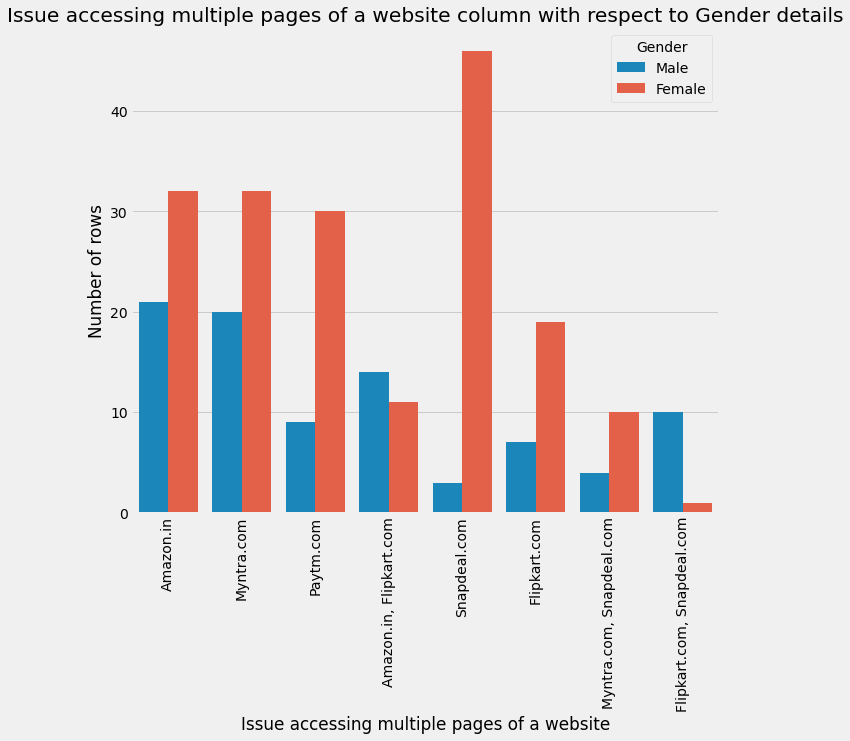

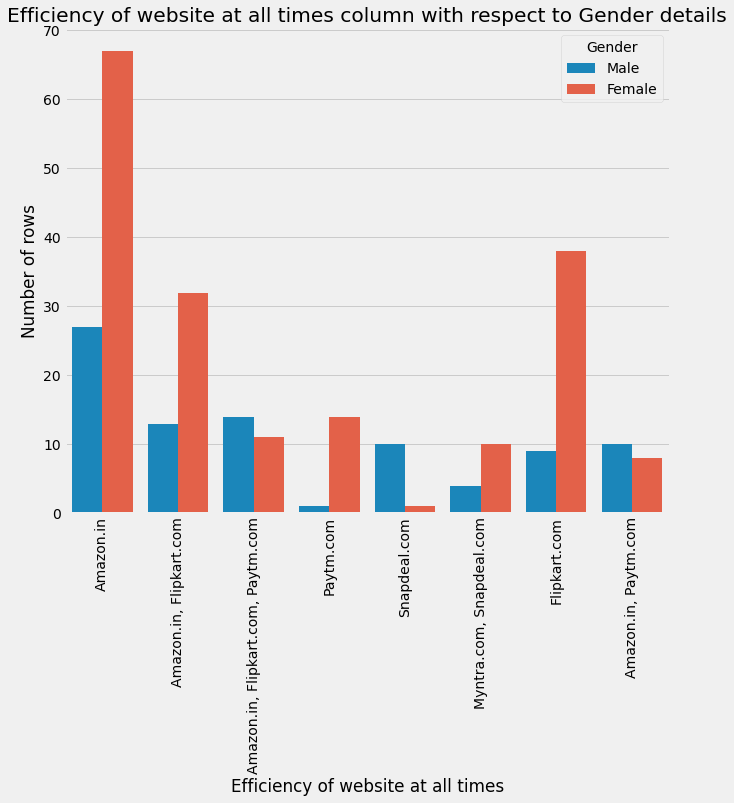

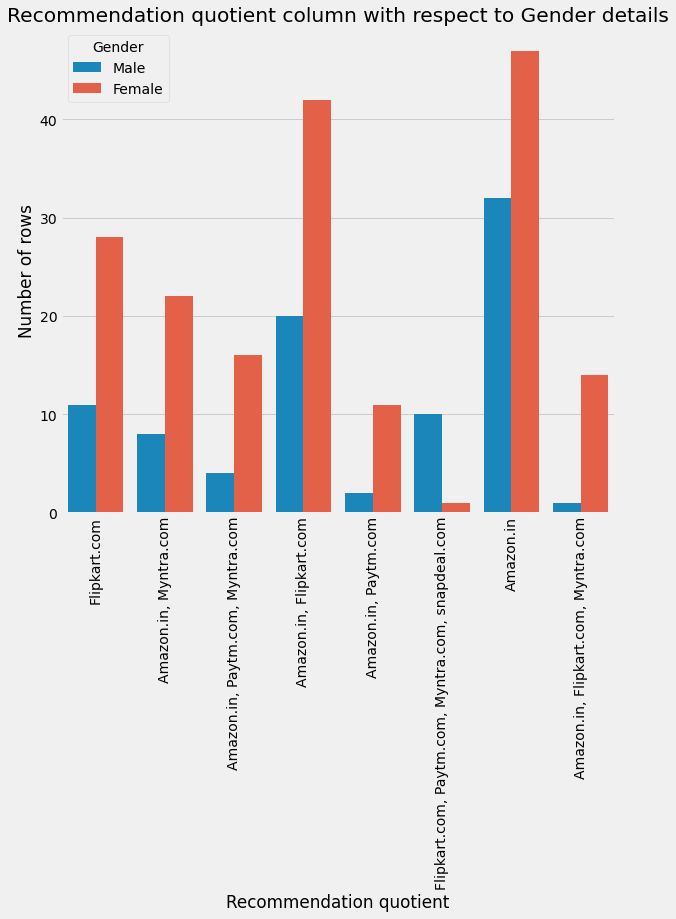

In [19]:
for col in df1:
    if col == "Gender":
        pass
    elif col == "Pin Code":
        pass
    else:
        plt.style.use('fivethirtyeight')
        plt.figure(figsize=(10,8))
        sns.countplot(x=col, data=df1, hue="Gender")
        plt.title("{} column with respect to Gender details".format(col))
        plt.tight_layout()
        plt.xticks(rotation=90)
        plt.ylabel("Number of rows")
        plt.show()

# Let's plot all feature columns count referring to the Age Group

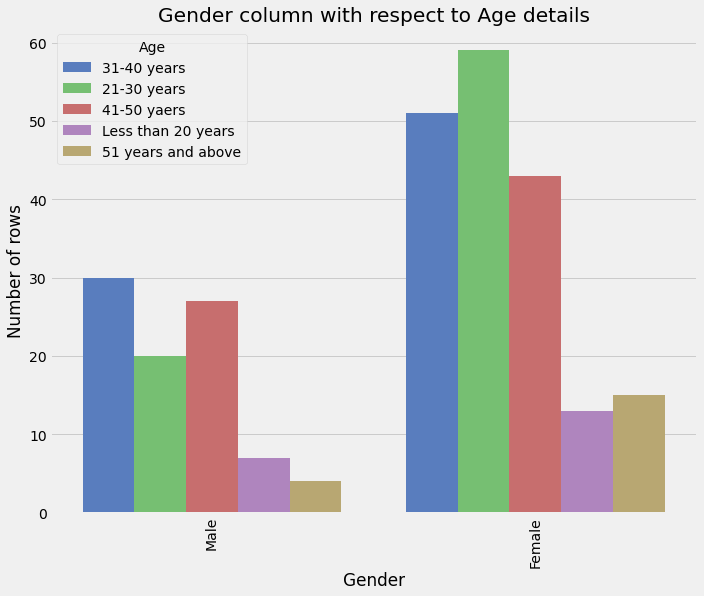

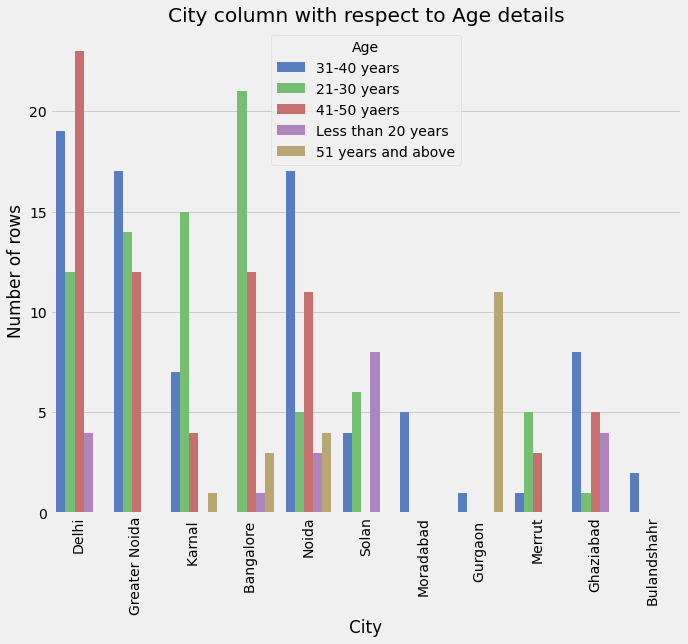

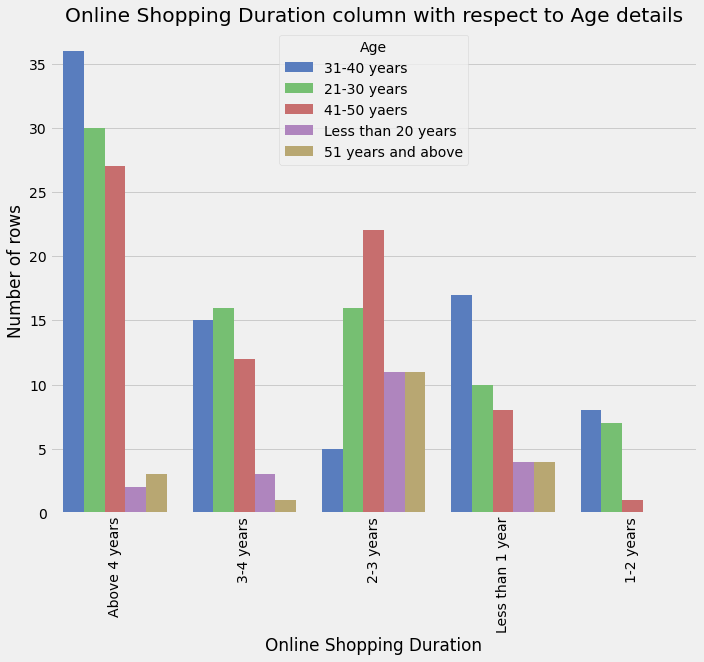

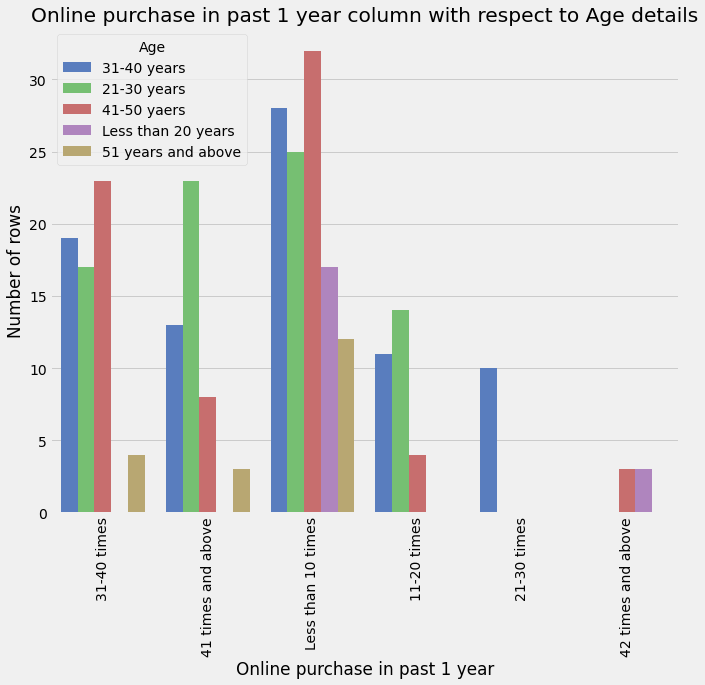

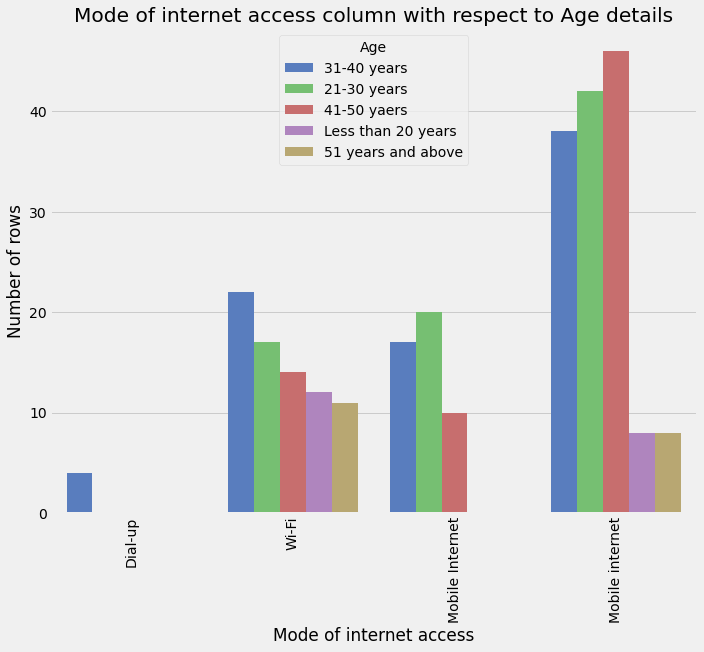

...

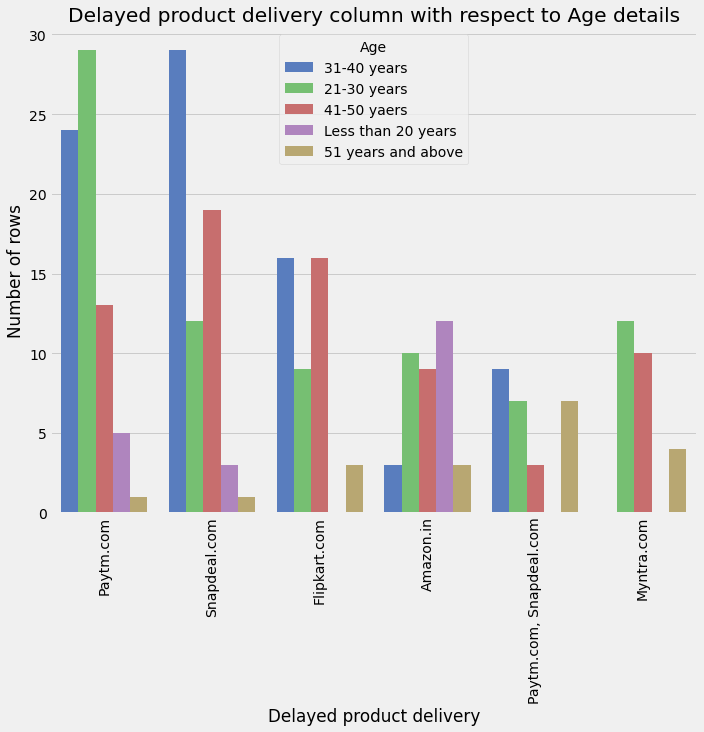

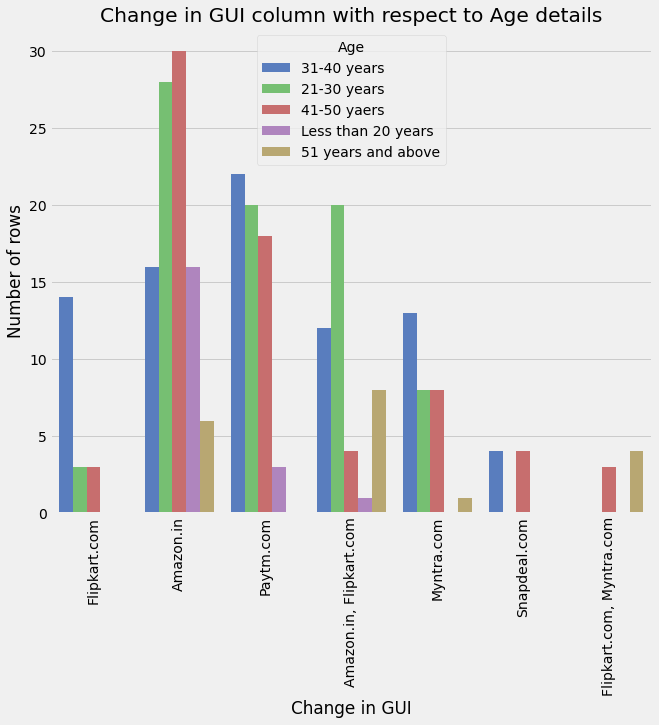

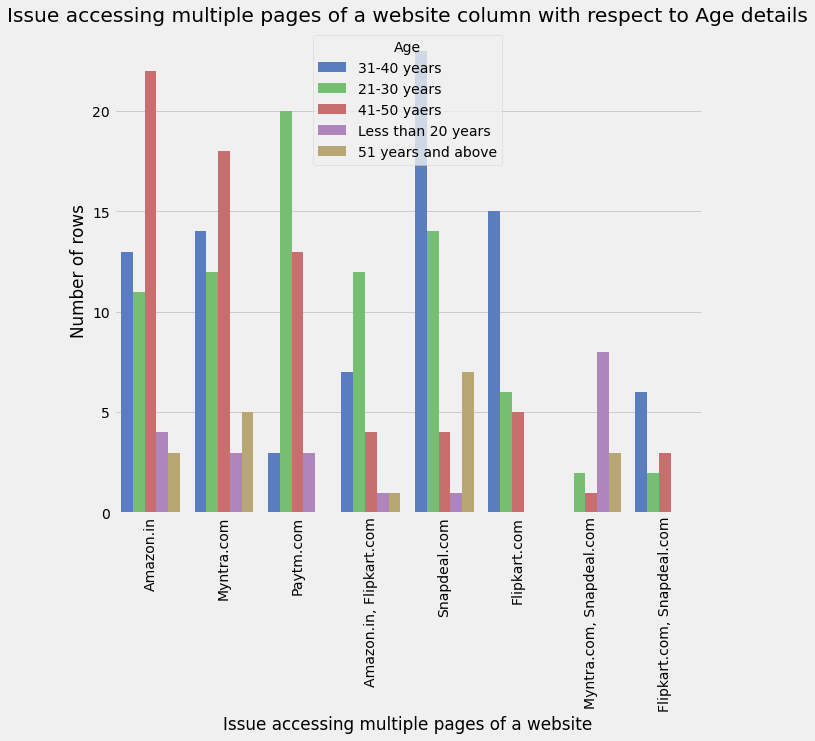

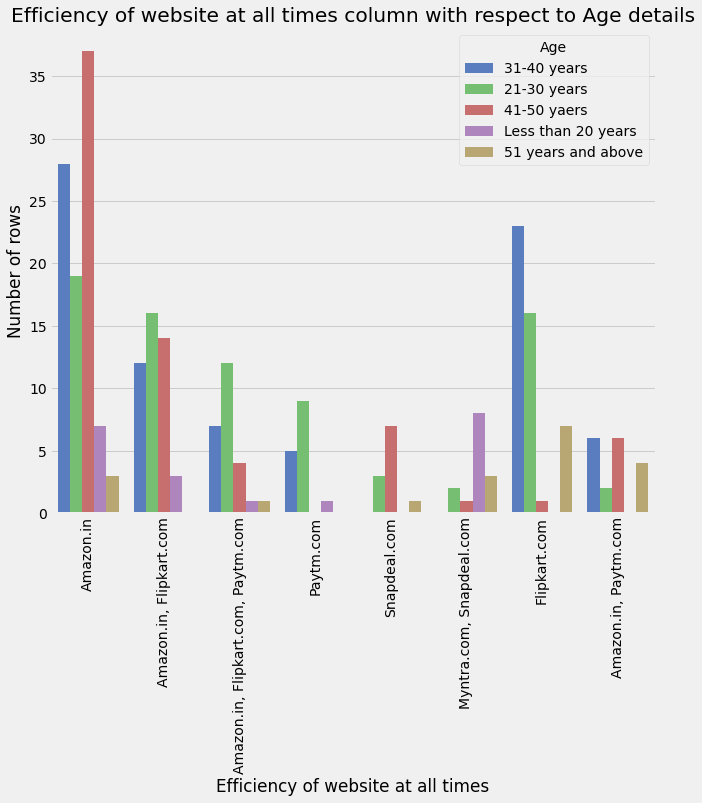

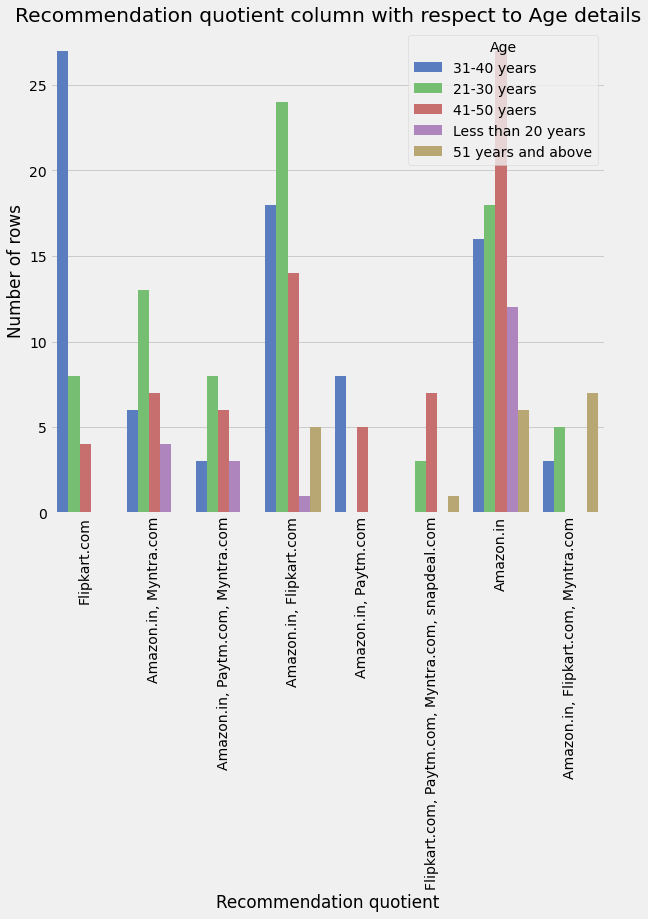

In [20]:
for col in df1:
    if col == "Age":
        pass
    elif col == "Pin Code":
        pass
    else:
        plt.style.use('seaborn-muted')
        plt.figure(figsize=(10,8))
        sns.countplot(x=col, data=df1, hue="Age")
        plt.title("{} column with respect to Age details".format(col))
        plt.tight_layout()
        plt.xticks(rotation=90)
        plt.ylabel("Number of rows")
        plt.show()

# Let's plot all feature columns count referring to the City

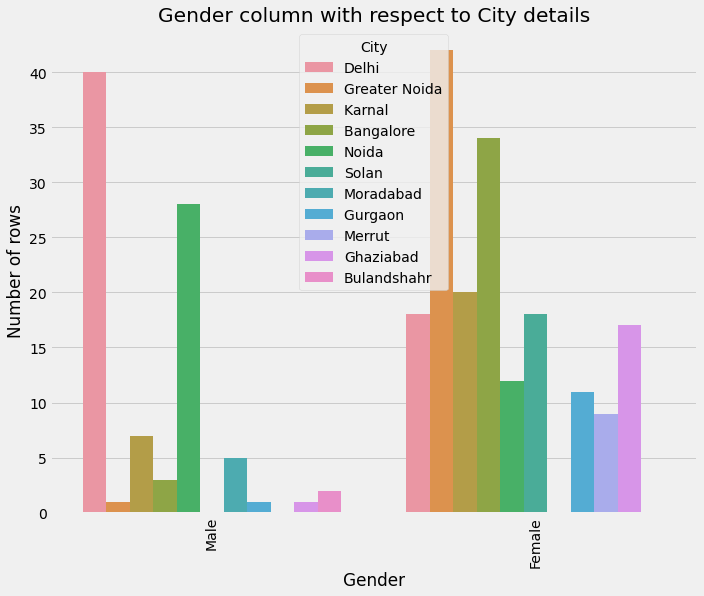

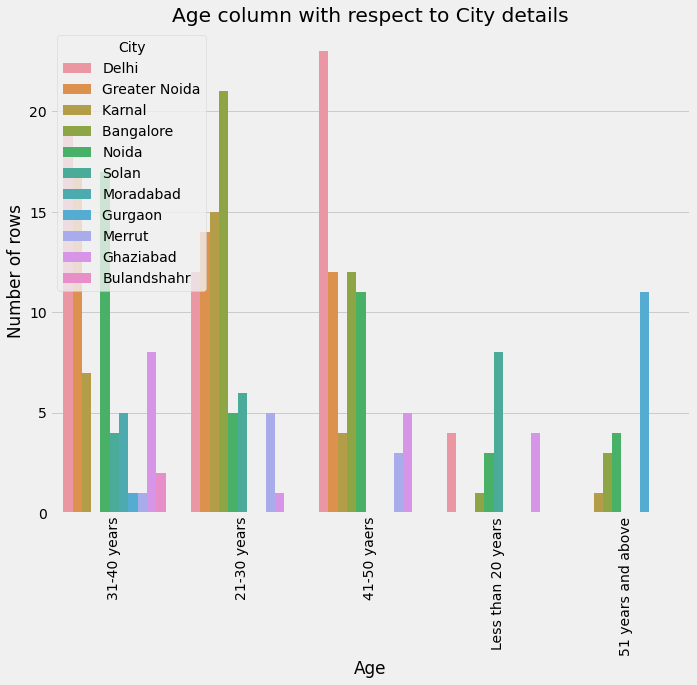

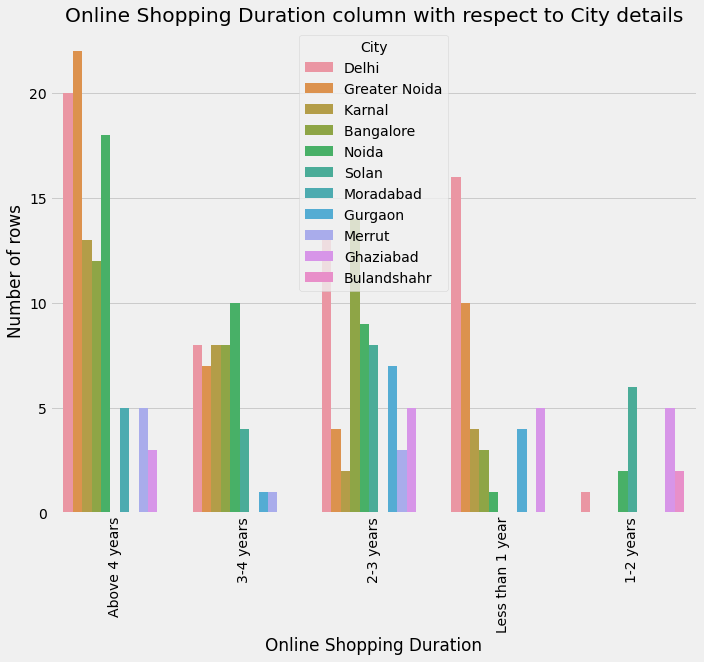

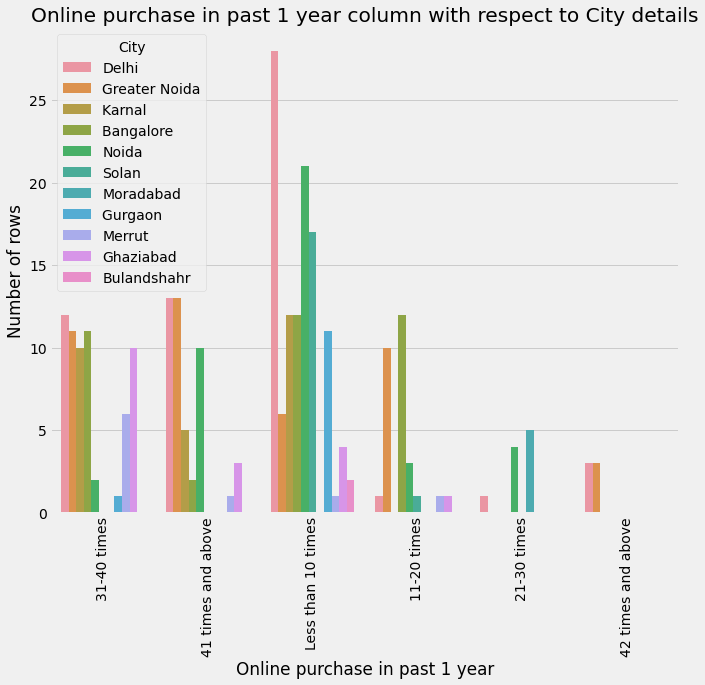

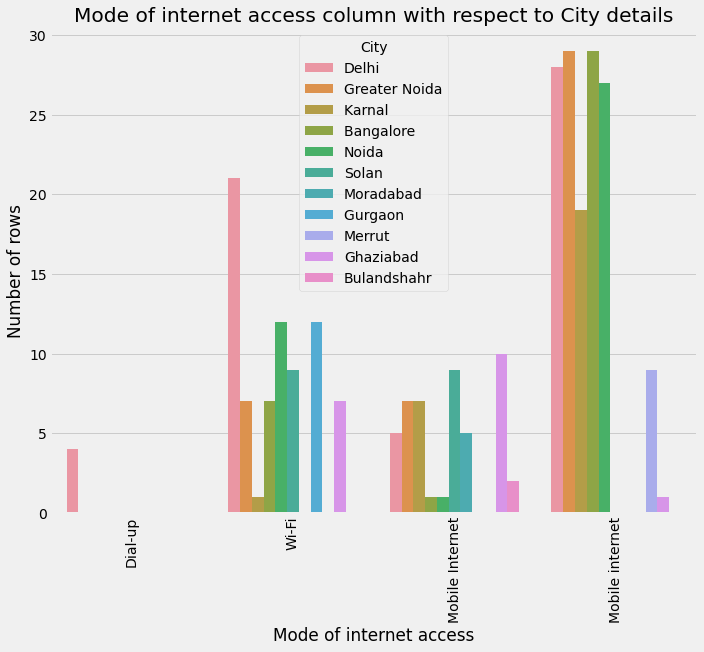

...

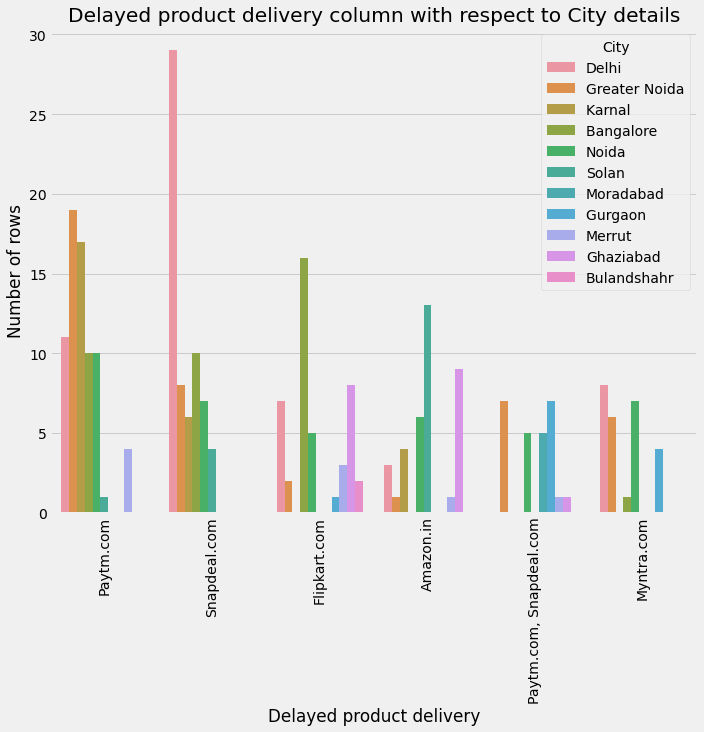

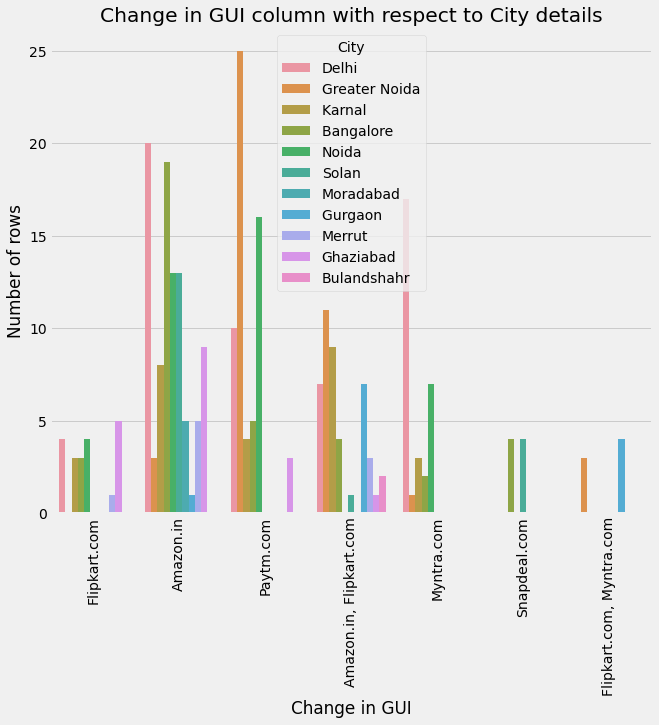

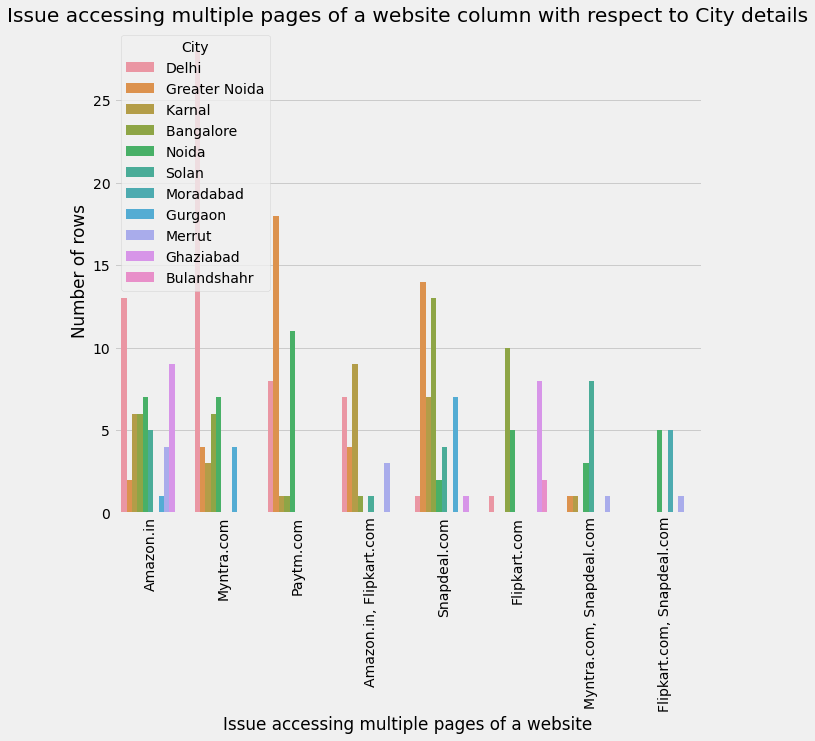

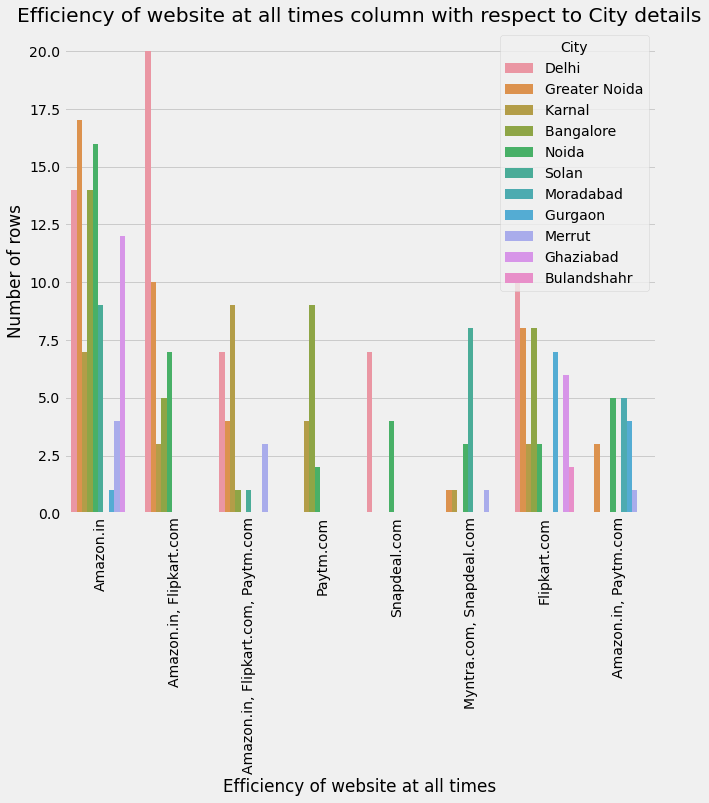

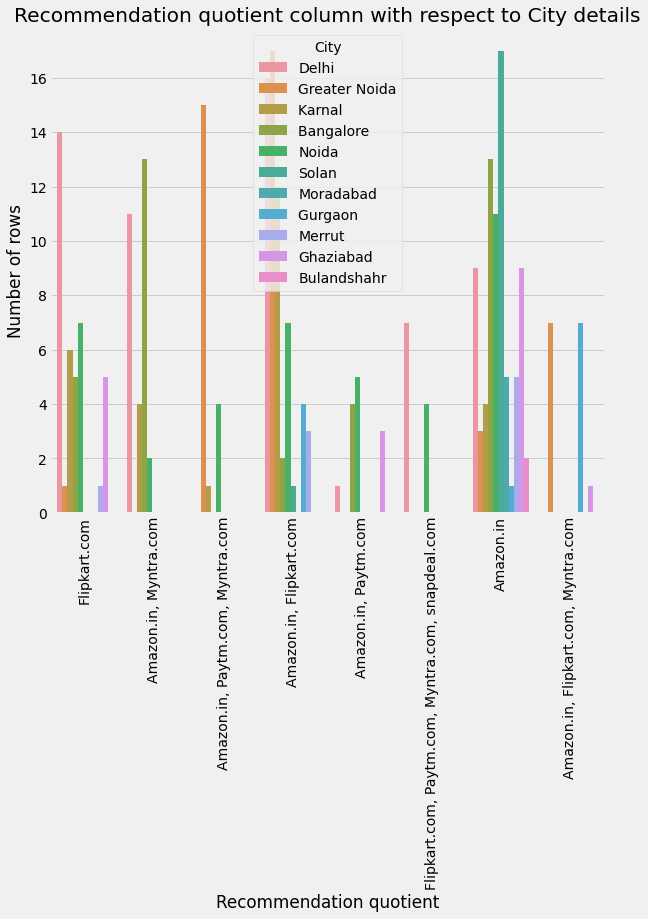

In [21]:
for col in df1:
    if col == "City":
        pass
    elif col == "Pin Code":
        pass
    else:
        plt.style.use('seaborn-colorblind')
        plt.figure(figsize=(10,8))
        sns.countplot(x=col, data=df1, hue="City")
        plt.title("{} column with respect to City details".format(col))
        plt.tight_layout()
        plt.xticks(rotation=90)
        plt.ylabel("Number of rows")
        plt.show()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

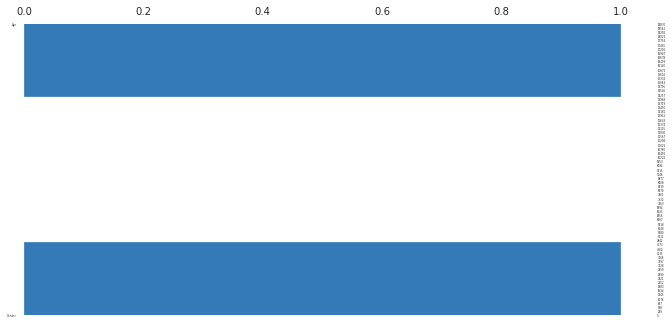

In [22]:
pandas_profiling.ProfileReport(df1)   

pandas-profiling is an open source Python module with which we can quickly do an exploratory data analysis with just a few lines of code. It generates interactive reports in web format that can be presented to any person, even if they don’t know programming. It also offers report generation for the dataset with lots of features and customizations for the report generated. In short, what pandas-profiling does is save us all the work of visualizing and understanding the distribution of each variable. It generates a report with all the information easily available.

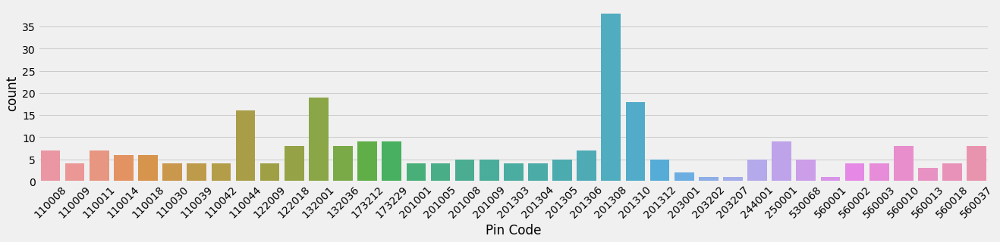

In [23]:
#Let's see the counts for pin codes
plt.figure(figsize=(20,4))
sns.countplot(x=df1['Pin Code'])
plt.xticks(rotation=45)
plt.show()

# Inferential Statistics

# First Hypothesis

H0: There is no association between gender and e-retail company (Gender and e-retail company are independent)

H1: There is an association between gender and e-retail company

# Chi Square Test

In [24]:
import scipy.stats as stats

In [25]:
# The 2 Columns needed are 1st and last
dataset_table=pd.crosstab(df1['Gender'],
                          df1['Recommendation quotient'])
dataset_table

Recommendation quotient,Amazon.in,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Myntra.com","Amazon.in, Myntra.com","Amazon.in, Paytm.com","Amazon.in, Paytm.com, Myntra.com",Flipkart.com,"Flipkart.com, Paytm.com, Myntra.com, snapdeal.com"
Gender,,,,,,,,
Female,47,42,14,22,11,16,28,1
Male,32,20,1,8,2,4,11,10


In [26]:
dataset_table.values

array([[47, 42, 14, 22, 11, 16, 28,  1],
       [32, 20,  1,  8,  2,  4, 11, 10]], dtype=int64)

In [27]:
#Observed Values
Observed_Values = dataset_table.values 
print("Observed Values :-\n",Observed_Values)

Observed Values :-
 [[47 42 14 22 11 16 28  1]
 [32 20  1  8  2  4 11 10]]


In [28]:
val=stats.chi2_contingency(dataset_table)

In [29]:
val

(27.83363335285096,
 0.0002356893927723333,
 7,
 array([[53.15613383, 41.71747212, 10.0929368 , 20.18587361,  8.7472119 ,
         13.45724907, 26.24163569,  7.40148699],
        [25.84386617, 20.28252788,  4.9070632 ,  9.81412639,  4.2527881 ,
          6.54275093, 12.75836431,  3.59851301]]))

In [30]:
Expected_Values=val[3]

In [31]:
Expected_Values

array([[53.15613383, 41.71747212, 10.0929368 , 20.18587361,  8.7472119 ,
        13.45724907, 26.24163569,  7.40148699],
       [25.84386617, 20.28252788,  4.9070632 ,  9.81412639,  4.2527881 ,
         6.54275093, 12.75836431,  3.59851301]])

In [32]:
no_of_rows=len(dataset_table.iloc[0:2,0])
no_of_columns=len(dataset_table.iloc[0,0:8])
ddof=(no_of_rows-1)*(no_of_columns-1)
print("Degree of Freedom:-",ddof)
alpha = 0.05

Degree of Freedom:- 7


In [33]:
from scipy.stats import chi2
chi_square=sum([(o-e)**2./e for o,e in zip(Observed_Values,Expected_Values)])
chi_square_statistic=chi_square[0]+chi_square[1]

In [34]:
print("chi-square statistic:-",chi_square_statistic)

chi-square statistic:- 2.1852257166231297


In [35]:
critical_value=chi2.ppf(q=1-alpha,df=ddof)
print('critical_value:',critical_value)

critical_value: 14.067140449340169


In [36]:
#p-value
p_value=1-chi2.cdf(x=chi_square_statistic,df=ddof)
print('p-value:',p_value)
print('Significance level: ',alpha)
print('Degree of Freedom: ',ddof)

p-value: 0.9488810780740886
Significance level:  0.05
Degree of Freedom:  7


In [37]:
if chi_square_statistic>=critical_value:
    print("Reject H0,There is an association between gender and e-retail company recommended to a friend")
else:
    print("Failed to Reject H0,There is no association between gender and e-retail company recommended to a friend")
    
if p_value<=alpha:
    print("Reject H0,There is an association between gender and e-retail company recommended to a friend")
else:
    print("Failed to Reject H0,There is no association between gender and e-retail company recommended to a friend")

Failed to Reject H0,There is no association between gender and e-retail company recommended to a friend
Failed to Reject H0,There is no association between gender and e-retail company recommended to a friend


# Second Hypothesis


H0: There is no association between age and e-retail company that person would recommend to a friend(age and e-retail company are independent)

H1: There is an association between age and e-retail company that person would recommend to a friend

In [38]:
# The 2 Columns needed are 1st and last
dataset_table=pd.crosstab(df1['Age'],
                          df1['Recommendation quotient'])
dataset_table

Recommendation quotient,Amazon.in,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Myntra.com","Amazon.in, Myntra.com","Amazon.in, Paytm.com","Amazon.in, Paytm.com, Myntra.com",Flipkart.com,"Flipkart.com, Paytm.com, Myntra.com, snapdeal.com"
Age,,,,,,,,
21-30 years,18,24,5,13,0,8,8,3
31-40 years,16,18,3,6,8,3,27,0
41-50 yaers,27,14,0,7,5,6,4,7
51 years and above,6,5,7,0,0,0,0,1
Less than 20 years,12,1,0,4,0,3,0,0


In [39]:
#Observed Values
Observed_Values = dataset_table.values 
print("Observed Values :-\n",Observed_Values)

Observed Values :-
 [[18 24  5 13  0  8  8  3]
 [16 18  3  6  8  3 27  0]
 [27 14  0  7  5  6  4  7]
 [ 6  5  7  0  0  0  0  1]
 [12  1  0  4  0  3  0  0]]


In [40]:
val=stats.chi2_contingency(dataset_table)

In [41]:
Expected_Values=val[3]
Expected_Values

array([[23.20074349, 18.20817844,  4.40520446,  8.81040892,  3.81784387,
         5.87360595, 11.4535316 ,  3.23048327],
       [23.78810409, 18.66914498,  4.51672862,  9.03345725,  3.91449814,
         6.02230483, 11.74349442,  3.31226766],
       [20.55762082, 16.133829  ,  3.90334572,  7.80669145,  3.38289963,
         5.20446097, 10.14869888,  2.86245353],
       [ 5.57992565,  4.37918216,  1.05947955,  2.11895911,  0.91821561,
         1.41263941,  2.75464684,  0.77695167],
       [ 5.87360595,  4.60966543,  1.11524164,  2.23048327,  0.96654275,
         1.48698885,  2.89962825,  0.81784387]])

In [42]:
no_of_rows=len(dataset_table.iloc[0:5,0])
no_of_columns=len(dataset_table.iloc[0,0:8])
ddof=(no_of_rows-1)*(no_of_columns-1)
print("Degree of Freedom:-",ddof)
alpha = 0.05

Degree of Freedom:- 28


In [43]:
chi_square=sum([(o-e)**2./e for o,e in zip(Observed_Values,Expected_Values)])
chi_square_statistic=chi_square[0]+chi_square[1]

In [44]:
print("chi-square statistic:-",chi_square_statistic)

chi-square statistic:- 17.219333961318835


In [45]:
critical_value=chi2.ppf(q=1-alpha,df=ddof)
print('critical_value:',critical_value)

critical_value: 41.33713815142739


In [46]:
#p-value
p_value=1-chi2.cdf(x=chi_square_statistic,df=ddof)
print('p-value:',p_value)
print('Significance level: ',alpha)
print('Degree of Freedom: ',ddof)
print('p-value:',p_value)

p-value: 0.9441297677059306
Significance level:  0.05
Degree of Freedom:  28
p-value: 0.9441297677059306


In [47]:
if chi_square_statistic>=critical_value:
    print("Reject H0,There is an association between age and e-retail company that person would recommend to a friend")
else:
    print("Failed to Reject H0, Therefore, There is no association between age and e-retail company that person would recommend to a friend")
    
if p_value<=alpha:
    print("Reject H0,There is an association between age and e-retail company that person would recommend to a friend")
else:
    print("Failed to Reject H0, Therefore, There is no association between age and e-retail company that person would recommend to a friend")

Failed to Reject H0, Therefore, There is no association between age and e-retail company that person would recommend to a friend
Failed to Reject H0, Therefore, There is no association between age and e-retail company that person would recommend to a friend


# Encoding the categorical object datatype columns


In [48]:
# Ordinal Encoding

oe = OrdinalEncoder()

def ordinal_encode(df, column):
    df[column] = oe.fit_transform(df[column])
    return df

oe_col = df1.columns
df=ordinal_encode(df1, oe_col)
df.head()

,Gender,Age,City,Pin Code,Online Shopping Duration,Online purchase in past 1 year,Mode of internet access,Device used for internet access,Screen size of mobile,Operating System,Browser,Channel used for 1st visit,Online store access post 1st visit,Time invested to explore and purchase,Preferred payment option,Frequency to abandon purchase from a cart,Reason to abandon purchase from a cart,Shopping website content readability,Importance of product comparison content,Importance of seller and product detail for purchase decision,Clarity on relevant information for products,Ease of navigation on website,Loading and processing speed of website,Ease of access on GUI of website,Convenient/Most used payment methods,On time product delivery,Empathy towards the customer,Privacy guarantee of the customer,Support availability via various means,Offers and Discounts on online shopping,Enjoyment quotient in online shopping,Flexibity in online shopping,Return and Replacement policy,Loyalty program benefits,Quality of website content,User satisfaction,Net benefit,User satisfaction with trust factor,Wide range of products,Relevance in product details,Monetary savings,Frequency of purchase from a seller,Sense of adventure,Social status,Pleasure in shopping from a seller,Fulfill roles from shopping,Value for money,List of online shopping websites,Ease of access on an online website,Website layout,Variety of products on offer,Completeness of product description,Website access speed,Reliability of website,Ease to complete purchase,Payment option availability,Fast delivery,Customer privacy,Security on payment details,Trust worthiness,Online presence of support team,Time to login website on special offer days,Time to load media on special offer days,Delay in declaring special offer details,Time to load website on special offer days,Limited mode of payment on special offer days,Delayed product delivery,Change in GUI,Issue accessing multiple pages of a website,Efficiency of website at all times,Recommendation quotient
0,1.0,1.0,2.0,1.0,3.0,2.0,0.0,0.0,3.0,2.0,0.0,2.0,2.0,2.0,2.0,2.0,2.0,0.0,2.0,2.0,0.0,0.0,4.0,1.0,1.0,1.0,1.0,0.0,0.0,4.0,3.0,1.0,1.0,0.0,2.0,2.0,0.0,2.0,3.0,3.0,1.0,2.0,0.0,0.0,2.0,0.0,1.0,7.0,9.0,7.0,5.0,10.0,9.0,9.0,8.0,9.0,0.0,0.0,0.0,7.0,9.0,0.0,0.0,3.0,5.0,0.0,3.0,2.0,0.0,0.0,6.0
1,0.0,0.0,2.0,5.0,3.0,3.0,3.0,2.0,0.0,1.0,0.0,2.0,4.0,4.0,1.0,3.0,4.0,2.0,3.0,3.0,2.0,2.0,3.0,3.0,2.0,2.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,4.0,4.0,2.0,2.0,1.0,2.0,3.0,5.0,6.0,2.0,2.0,8.0,2.0,2.0,1.0,9.0,9.0,8.0,2.0,1.0,6.0,7.0,10.0,7.0,5.0,0.0,4.0,1.0,3.0
2,0.0,0.0,4.0,23.0,2.0,3.0,1.0,2.0,2.0,0.0,0.0,2.0,4.0,1.0,2.0,2.0,4.0,2.0,0.0,0.0,0.0,0.0,0.0,3.0,2.0,2.0,1.0,1.0,1.0,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,0.0,2.0,2.0,2.0,0.0,0.0,0.0,4.0,4.0,0.0,8.0,7.0,6.0,4.0,7.0,7.0,6.0,5.0,10.0,0.0,0.0,6.0,6.0,8.0,7.0,6.0,4.0,7.0,0.0,3.0,5.0,6.0,0.0,5.0
3,1.0,0.0,6.0,11.0,2.0,5.0,1.0,2.0,2.0,1.0,3.0,2.0,2.0,2.0,1.0,1.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0,3.0,2.0,0.0,1.0,1.0,0.0,0.0,4.0,3.0,0.0,4.0,2.0,0.0,3.0,0.0,0.0,0.0,2.0,0.0,0.0,2.0,0.0,4.0,0.0,4.0,4.0,3.0,1.0,1.0,6.0,3.0,3.0,2.0,3.0,2.0,5.0,5.0,3.0,9.0,7.0,4.0,8.0,5.0,3.0,1.0,1.0,2.0,1.0
4,0.0,0.0,0.0,31.0,1.0,0.0,3.0,2.0,0.0,1.0,3.0,0.0,4.0,4.0,1.0,0.0,0.0,2.0,2.0,2.0,0.0,0.0,3.0,3.0,2.0,0.0,1.0,0.0,1.0,2.0,2.0,2.0,2.0,1.0,0.0,2.0,2.0,2.0,0.0,0.0,2.0,0.0,4.0,3.0,2.0,3.0,1.0,4.0,4.0,9.0,7.0,5.0,0.0,6.0,4.0,4.0,0.0,7.0,10.0,6.0,5.0,5.0,8.0,5.0,8.0,7.0,3.0,0.0,7.0,6.0,3.0


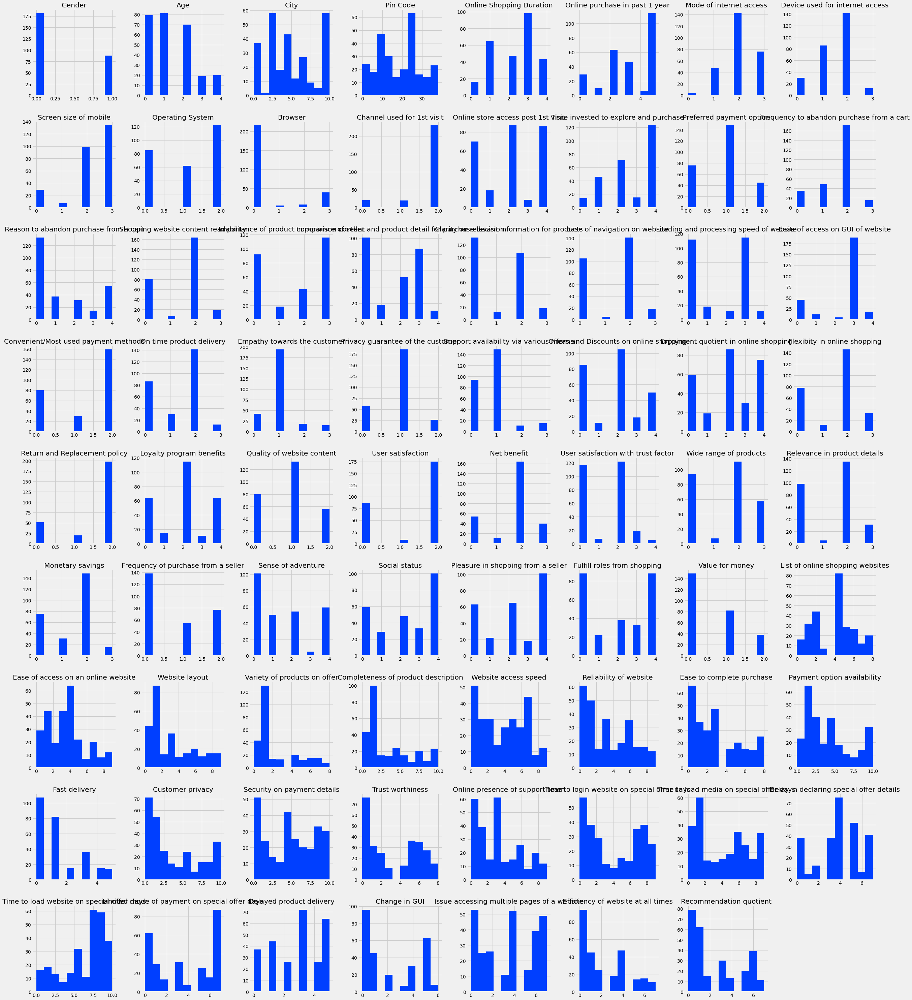

In [49]:
plt.style.use('seaborn-bright')

df.hist(figsize=(40,50))
plt.show()

# Correlation using a Heatmap

• Positive correlation - A correlation of +1 indicates a perfect positive correlation, meaning that both variables move in the same direction together.


• Negative correlation - A correlation of –1 indicates a perfect negative correlation, meaning that as one variable goes up, the other goes down.

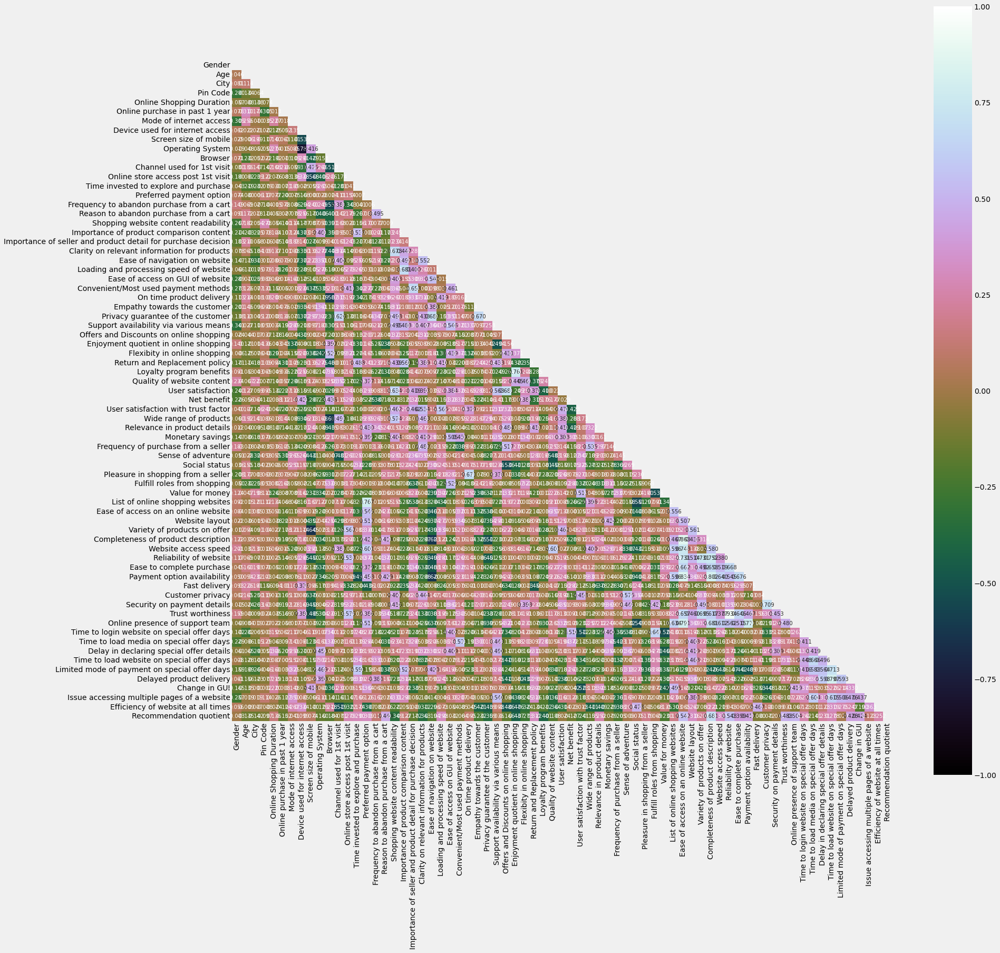

In [50]:
upper_triangle = np.triu(df1.corr())
plt.figure(figsize=(25,25))
sns.heatmap(df1.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', 
            annot_kws={'size':10}, cmap="cubehelix", mask=upper_triangle)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.show()

In the above heatmap due to lot of columns we are not able to see the correlation details however we can observe the color coding details and get a hint that there is no multi collinearity concern between the column values.

# Correlation Bar Plot comparing Gender column with the remaining columns


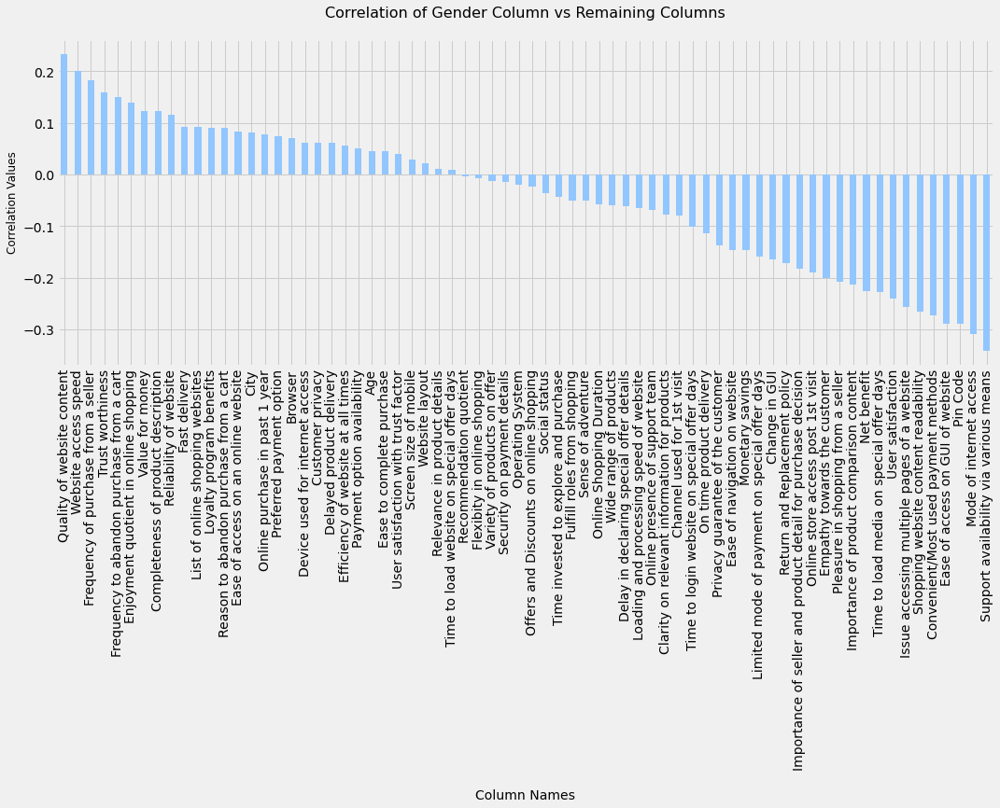

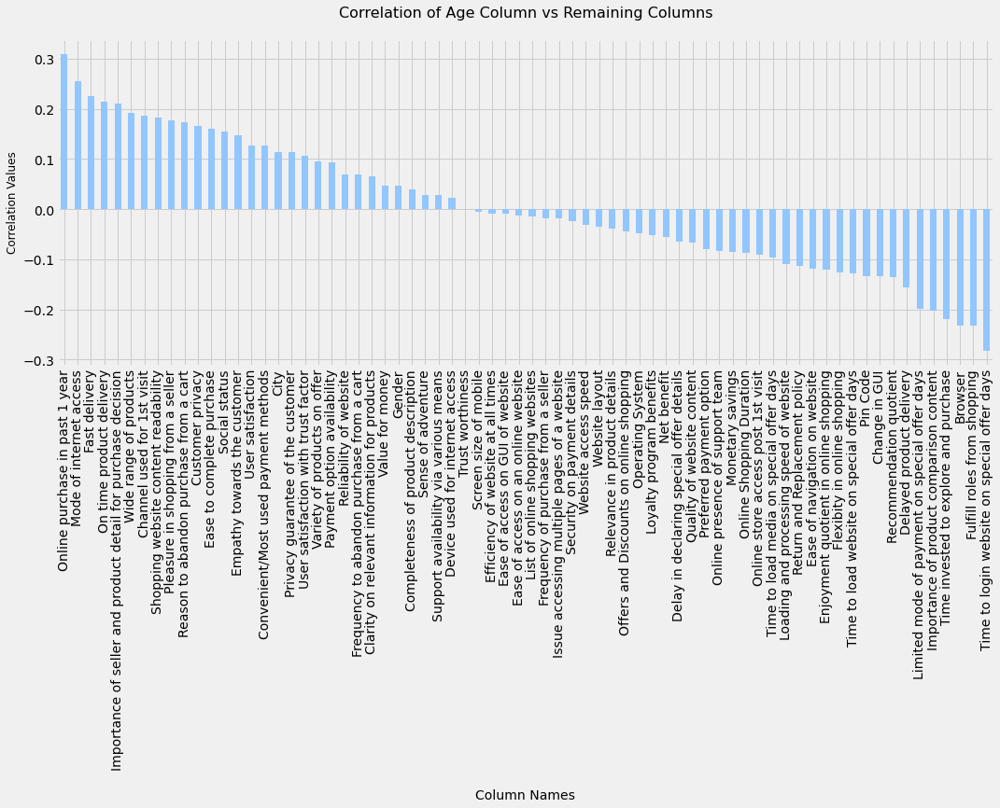

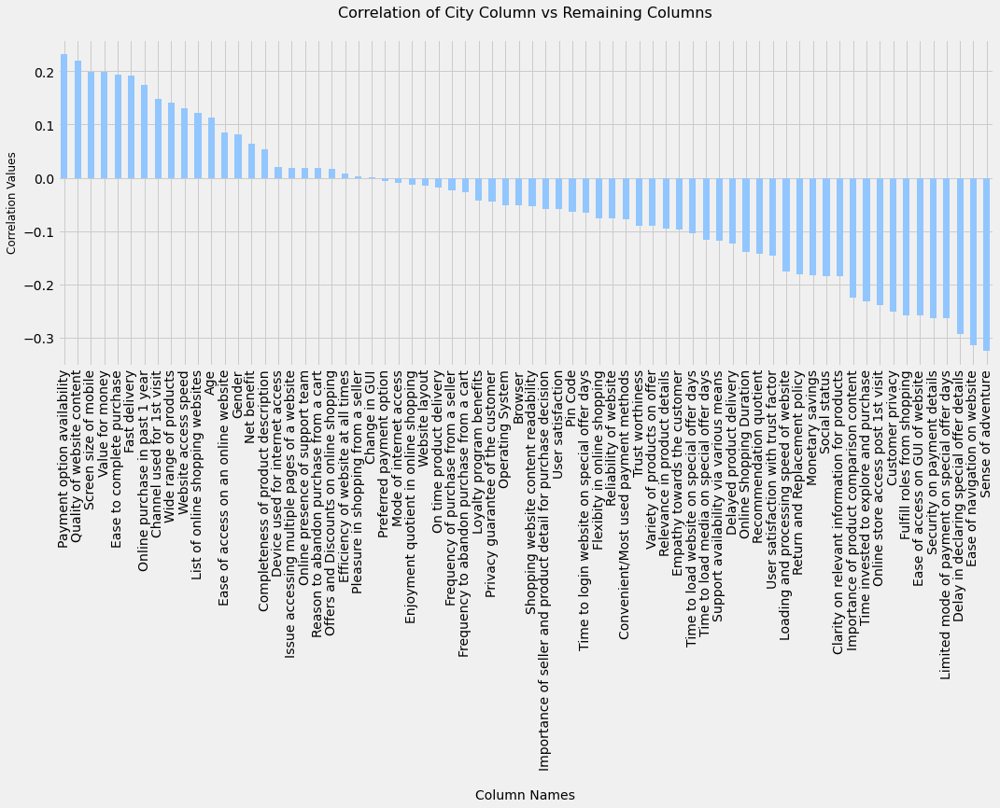

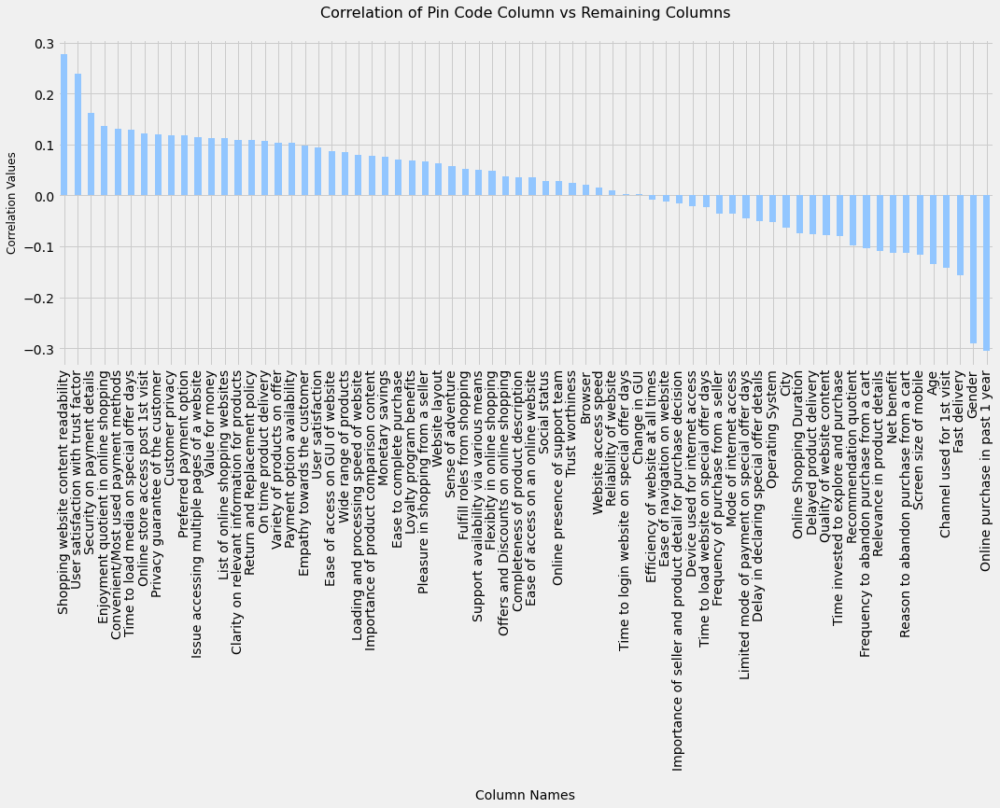

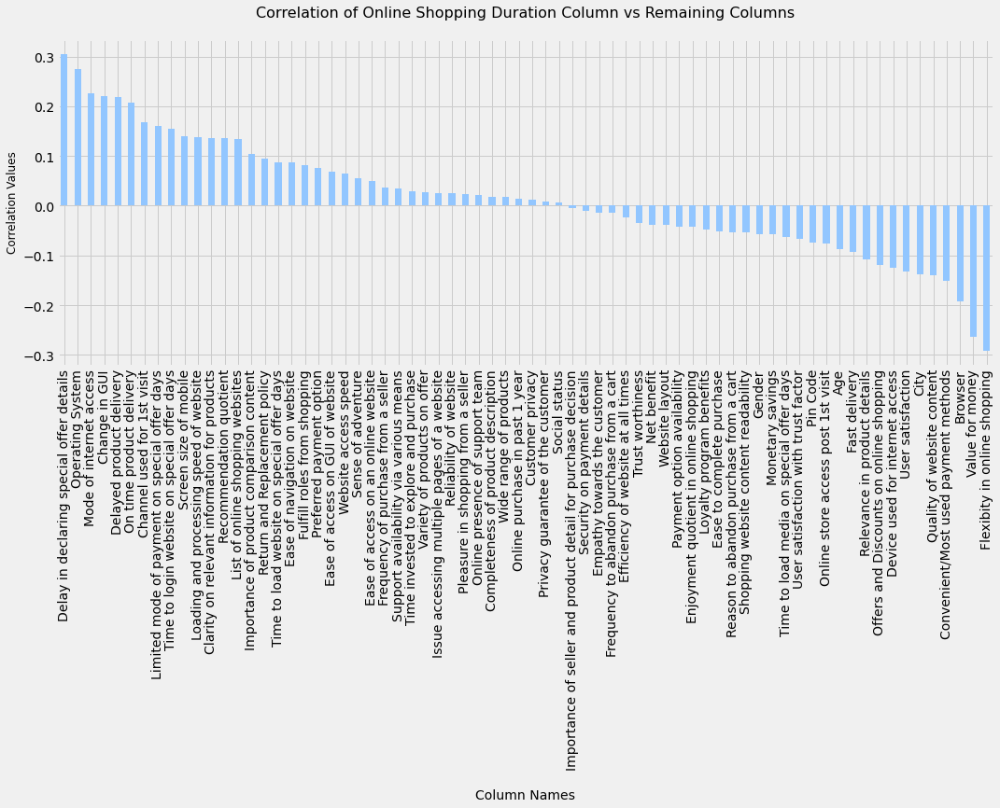

...

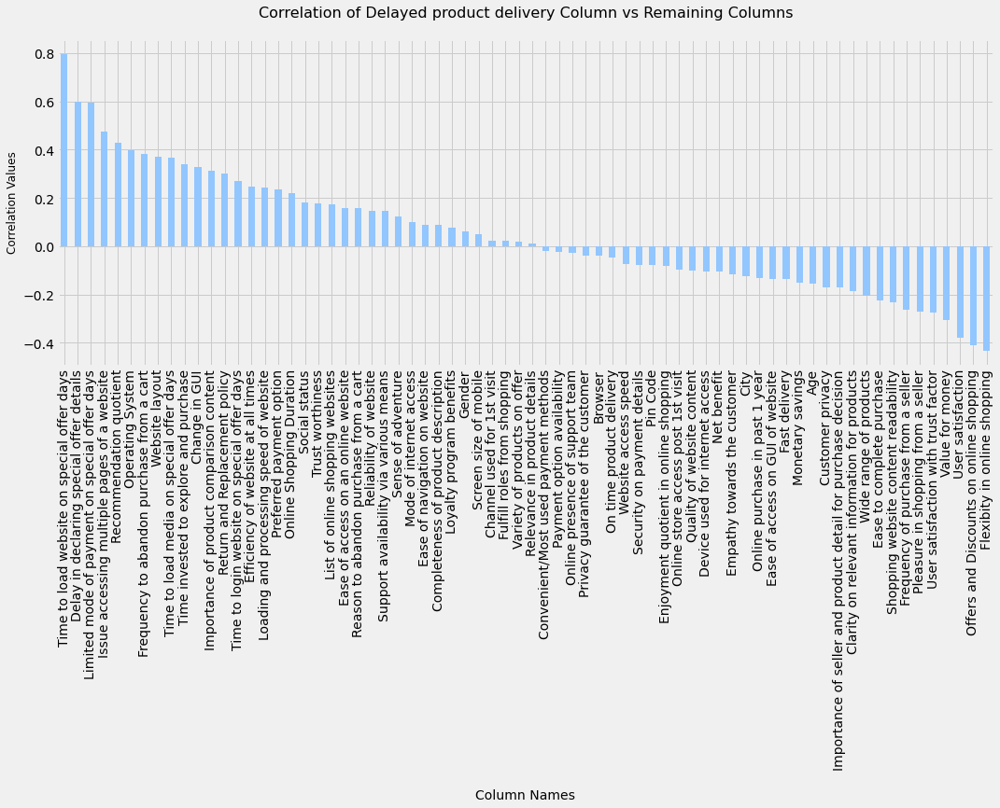

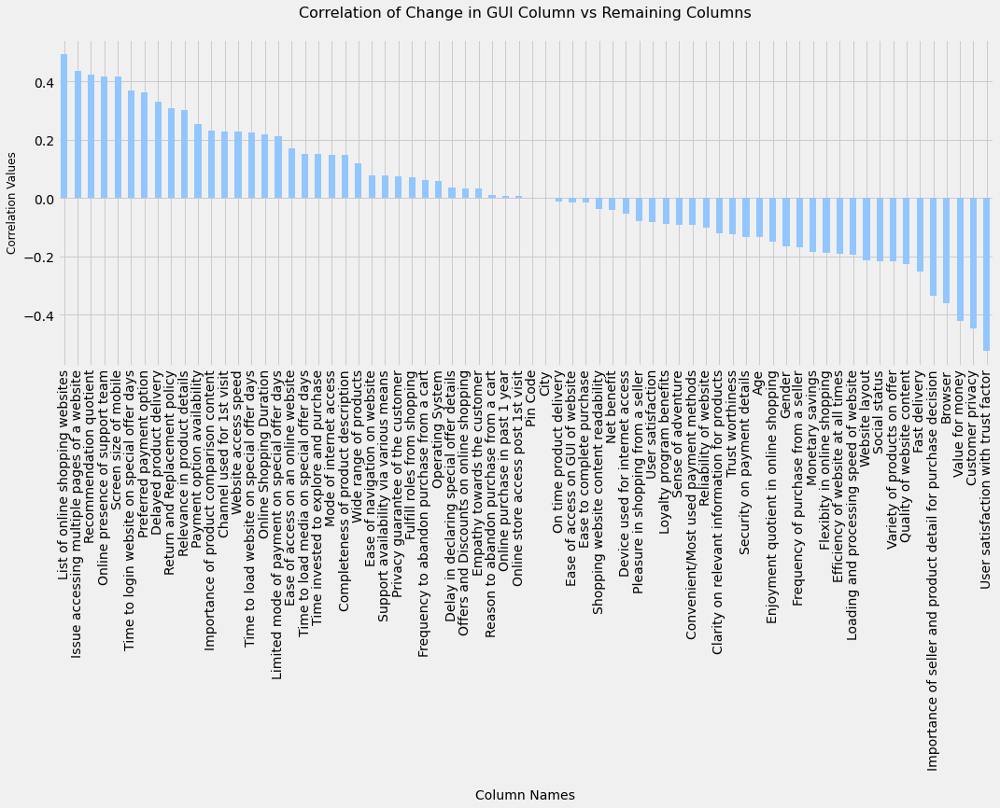

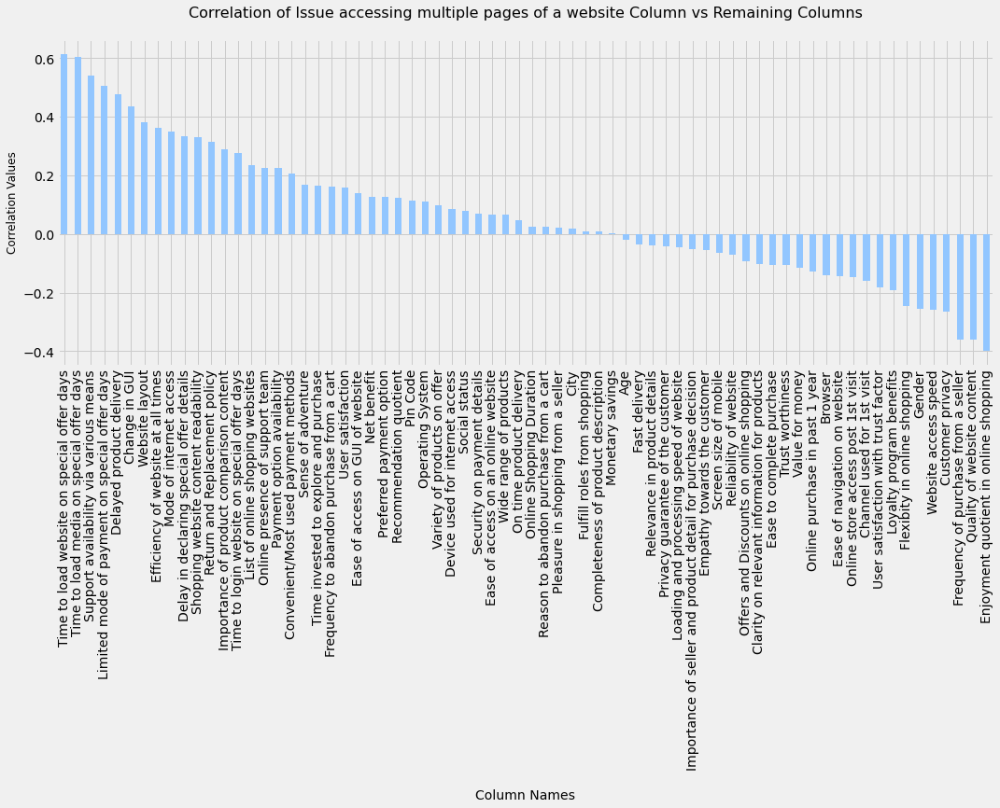

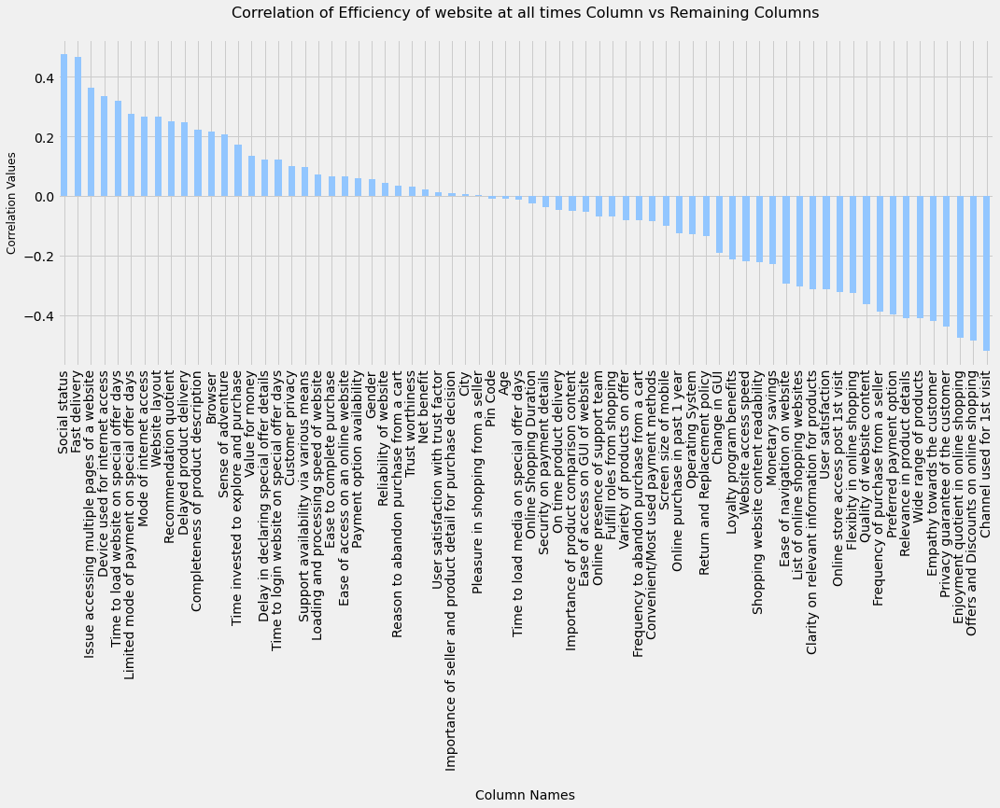

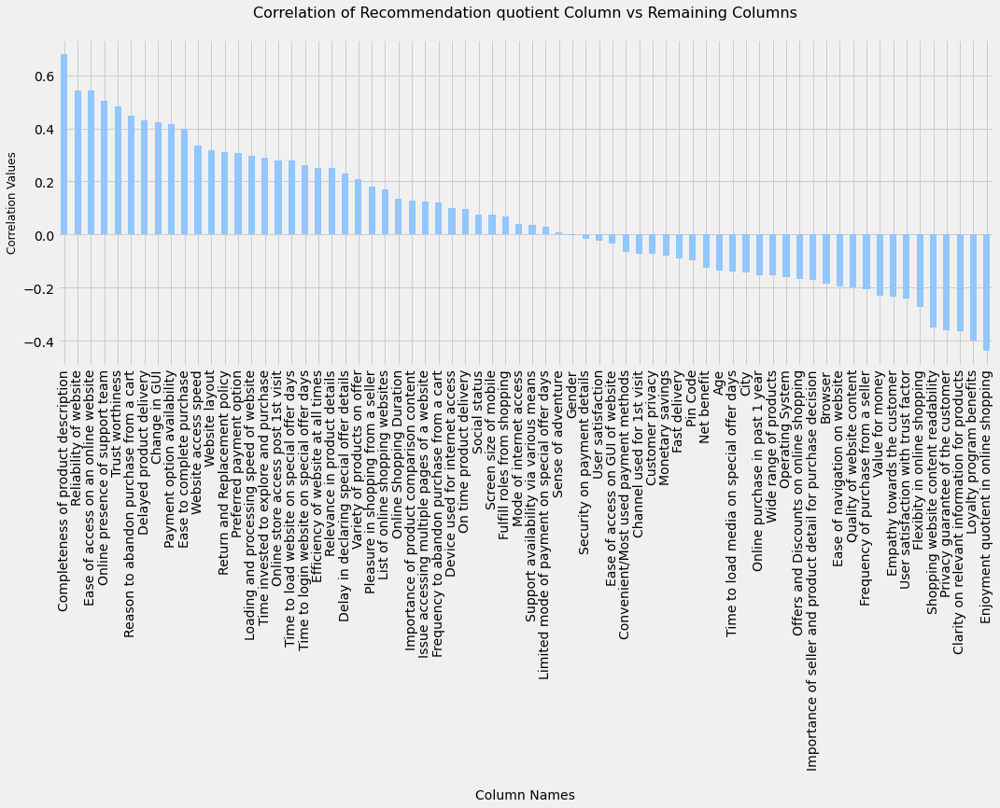

In [51]:
plt.style.use('seaborn-pastel')

column_names = df1.columns
for col in df1[column_names]:
    df_corr = df1.corr()
    plt.figure(figsize=(16,6))
    df_corr[col].sort_values(ascending=False).drop(col).plot.bar()
    plt.title("Correlation of {} Column vs Remaining Columns\n".format(col), fontsize=16)
    plt.xlabel("\nColumn Names", fontsize=14)
    plt.ylabel("Correlation Values", fontsize=12)
    plt.show()

Since the heatmap was not clear in terms of it's values I have generated this barplot for each column vs remaining column showing the positive and negative correlation data.

# Inference:¶

# 1. Amazon.com

To be improved:
    
1. During promotions, try to give a disturbance free shopping experience to customers.
2. Give more payment options to customers.
3. Try to give price early during promotion.
4. Reduce the delivery time of the products.

Positive feedback summary:
    
1. Convenient to use and also a good website for shopping.
2. Fast delivery of products.
3. Availability of complete information of the products.
4. Presence of online assistance through multi-channels.
5. Reliable website or app, perceived trustworthiness.

# 2. Flipkart.com

To be improved:
    
1. During promotions, try to give a disturbance free shopping experience to customers.
2. Give more payment options to customers.
3. Try to give the price early during promotion.
4. Reduce the delivery time of the products.
5. Flipkart and Amazon almost share the same feedbacks with varying percentages as the only difference.

Positive feedback summary:
    
1. Convenient to use and also a good website for shopping.
2. Fast delivery of products.
3. Availability of complete information of the products.
4. Presence of online assistance through multi-channels.
5. Reliable website or app, perceived trustworthiness.
6. Wild variety of products to offer.

# 3. Myntra.com

To be improved:
    
1. During promotions, try to give a disturbance free shopping experience to customers.
2. Try to give the price early during promotions.
3. Reduce the delivery time of the products during promotions.

Positive feedback summary:
    
1. Convenient to use and also a good website.
2. Availability of several payment options.
3. Faster products delivery.
4. Complete information of products available.
5. Reliable website or app, perceived trustworthiness.
6. Wild variety of product to offer

# 4. Paytm.com

To be improved:
    
1. Reduce the delivery time of the products during promotions.
2. Try to give the price early during promotion.
3. During promotions, try to give a disturbance free shopping experience to customers.
4. Late declaration of price and discounts.
5. Frequent disturbance is occurring while moving from one page to another.

Positive feedback summary

1. Convenient to use and a good website.
2. Quickness to complete a purchase.
3. About 64% of the customers feel that either web or app is reliable.
4. Around 20% of the customers believe that paytm has a wild variety of products on offer.

# 5. Snapdeal.com

To be improved:
    
1. Reduce the delivery time of the products during promotions.
2. Try to give the price early during promotion.
3. During promotions, try to give a disturbance free shopping experience to customers.
4. Late declaration of price and discounts.
5. No one has expressed to recommend snapdeal to a contact as it has the most negative feedbacks among all other websites.

Positive feedback summary:
    
1. Convenient to use.
2. 54% of the customers are happy about the availability of financial information security.

# Conclusion:¶


• Based on overall observations, the first 47 features provide insights into how e-tailer is helpful & growing based on customer   inputs. The data explained how the online platform has been used more often in which CITY,PIN CODE, AGE GROUP, etc. It also     showed that in some factors there is less importance given to contribute to the success of an e-commerce store, so based on     that we could remove those factors & keep all the important factors, also we could improve on some factors that influence the   online customers repeat purchase intention.

• Apart from the first 47 features, the rest of the features showed which online platform has been used more based on the         success factors. Based on the case study for customer activation & retention, Amazon is most reliable and has been fulfilled     the customer requirements. After Amazon, data showed Flipkart has been used more for online shopping.

• The case study from Indian e-commerce customers showed Amazon and Flipkart has been used mostly for Online Shopping and most     recommended by Friends. So, based on the research factors, Amazon & Flipkart are the e-commerce platform, which are having the   combination of both utilitarian and hedonistic values to keep the repeat purchase intention (loyalty) positively.